# Mounting the Drive

In [ ]:

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:

import os

# Define the target directory
target_dir = "/content/drive/MyDrive/Colab Notebooks/"

# Create the directory if it doesn't exist
os.makedirs(target_dir, exist_ok=True)

# Change the current working directory
os.chdir(target_dir)

# Verify the current working directory
print(f"Current working directory: {os.getcwd()}")


Current working directory: /content/drive/MyDrive/Colab Notebooks


# Installations

In [ ]:
!pip -q install nd2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 245.1/245.1 kB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.1/224.1 kB 18.6 MB/s eta 0:00:00


In [ ]:
!pip -q install nd2reader

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.8/87.8 kB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


# Imports

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path
import nd2
import os
import torch
import cv2
import csv

# Working with ND2 file

In [ ]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/')
file = nd2.ND2File('7.1- 003.nd2')
data = file.read_frame(0).copy()
data

array([[139, 115, 128, ..., 173, 150, 133],
       [104, 119, 118, ..., 149, 162, 152],
       [122, 119, 117, ..., 162, 173, 153],
       ...,
       [126, 117, 102, ..., 126, 146, 140],
       [118, 104, 100, ..., 121, 119, 134],
       [109,  99, 109, ..., 120, 121, 123]], dtype=uint16)

In [ ]:

data.mean(), data.std(), data.min(), data.max()

(np.float64(750.4584416361529),
 np.float64(475.9271241839237),
 np.uint16(87),
 np.uint16(23834))

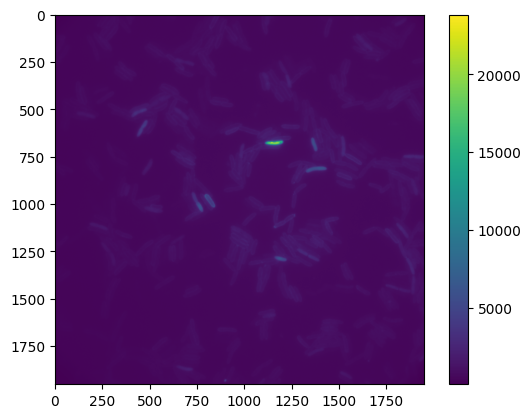

In [ ]:
img = nd2.imread('7.1- 003.nd2')
plt.imshow(img[0])
plt.colorbar()
plt.show()

In [ ]:
img.shape

(76, 1952, 1952)

In [ ]:
calibrationFactor = file.metadata.channels[0].volume.axesCalibration[0] * 1e-6
calibrationFactor

4.333333333333333e-08

In [ ]:
numberOfPixels = np.array((file.metadata.channels[0].volume.voxelCount[0],
                                file.metadata.channels[0].volume.voxelCount[1]))
numberOfPixels

array([1952, 1952])

Maximum value for Postion X, Postion Y

In [ ]:
max_pos = (numberOfPixels * calibrationFactor)[0]
max_pos

np.float64(8.458666666666666e-05)

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/Chp B Replicate 2 200 MS060.csv')
df.head()

,Name,Length,Width,Angle,Position X,Position Y,Color R,Color G,Color B,Type
0,Box 1,0.000005,0.000002,1.308997,0.000014,0.000078,0.509804,0.901961,0.509804,1
1,Box 2,0.000004,0.000002,0.593412,0.000011,0.000069,0.509804,0.901961,0.509804,1
2,Box 3,0.000005,0.000002,0.645772,0.000012,0.000059,0.509804,0.901961,0.509804,1
3,Box 4,0.000005,0.000002,0.767945,0.000017,0.000060,0.509804,0.901961,0.509804,1
4,Box 5,0.000004,0.000002,0.802851,0.000018,0.000050,0.509804,0.901961,0.509804,1


In [ ]:
df.describe()

,Length,Width,Angle,Position X,Position Y,Color R,Color G,Color B,Type
count,2.500000e+02,2.500000e+02,250.000000,2.500000e+02,2.500000e+02,250.000000,250.000000,250.000000,250.000000
mean,3.511600e-06,1.290800e-06,0.126292,4.583140e-05,4.334902e-05,0.391373,0.761584,0.724078,2.644000
std,9.621687e-07,1.616784e-07,1.009671,2.452954e-05,2.545581e-05,0.425432,0.258822,0.216193,1.446941
min,1.200000e-06,1.000000e-06,-1.623156,3.485410e-07,1.256547e-07,0.000000,0.000000,0.235294,1.000000
25%,2.800000e-06,1.200000e-06,-0.850848,2.657030e-05,2.182537e-05,0.000000,0.862745,0.509804,2.000000
50%,3.300000e-06,1.300000e-06,0.314159,4.931953e-05,4.237870e-05,0.000000,0.862745,0.862745,2.000000
75%,4.200000e-06,1.500000e-06,1.047198,6.654010e-05,6.537410e-05,0.784314,0.901961,0.862745,3.000000
max,7.400000e-06,1.700000e-06,1.832596,8.433788e-05,8.425550e-05,1.000000,1.000000,1.000000,6.000000


# Convert to 8 Co-ordinates format

Make sure to make classes classification to binary ( full or partial cell )

In [ ]:
df.head()

,Name,Length,Width,Angle,Position X,Position Y,Color R,Color G,Color B,Type
0,Box 1,0.000005,0.000002,1.308997,0.000014,0.000078,0.509804,0.901961,0.509804,1
1,Box 2,0.000004,0.000002,0.593412,0.000011,0.000069,0.509804,0.901961,0.509804,1
2,Box 3,0.000005,0.000002,0.645772,0.000012,0.000059,0.509804,0.901961,0.509804,1
3,Box 4,0.000005,0.000002,0.767945,0.000017,0.000060,0.509804,0.901961,0.509804,1
4,Box 5,0.000004,0.000002,0.802851,0.000018,0.000050,0.509804,0.901961,0.509804,1


In [ ]:
def calculate_corners(df):
    results = []
    for _, row in df.iterrows():
        class_index = 2 if row['Type'] == 6 else 1 if row['Type'] == 4 else 0
        # class_index = row['Type']
        length = row['Length']
        width = row['Width']
        angle = row['Angle']
        pos_x = row['Position X']
        pos_y = row['Position Y']

        x1 = pos_x + length/2 * np.cos(angle) - width/2 * np.sin(angle)
        y1 = pos_y + length/2 * np.sin(angle) + width/2 * np.cos(angle)
        x2 = pos_x - length/2 * np.cos(angle) - width/2 * np.sin(angle)
        y2 = pos_y - length/2 * np.sin(angle) + width/2 * np.cos(angle)
        x3 = pos_x - length/2 * np.cos(angle) + width/2 * np.sin(angle)
        y3 = pos_y - length/2 * np.sin(angle) - width/2 * np.cos(angle)
        x4 = pos_x + length/2 * np.cos(angle) + width/2 * np.sin(angle)
        y4 = pos_y + length/2 * np.sin(angle) - width/2 * np.cos(angle)
        results.append([class_index, x1, y1, x2, y2, x3, y3, x4, y4])

    return pd.DataFrame(results, columns=['class_index', 'x1', 'y1', 'x2', 'y2', 'x3', 'y3', 'x4', 'y4'])

result_df = calculate_corners(df)
result_df.head()

,class_index,x1,y1,x2,y2,x3,y3,x4,y4
0,0,0.000014,0.000080,0.000013,0.000076,0.000014,0.000076,0.000015,0.000080
1,0,0.000013,0.000071,0.000009,0.000068,0.000010,0.000067,0.000014,0.000069
2,0,0.000013,0.000061,0.000009,0.000058,0.000010,0.000057,0.000014,0.000060
3,0,0.000018,0.000062,0.000015,0.000059,0.000016,0.000058,0.000019,0.000061
4,0,0.000018,0.000052,0.000016,0.000049,0.000017,0.000048,0.000020,0.000051


In [ ]:
nrm_df = pd.concat([result_df.iloc[:, 0], result_df.iloc[:, 1:] / max_pos], axis=1)
nrm_df.head()

,class_index,x1,y1,x2,y2,x3,y3,x4,y4
0,0,0.165506,0.950399,0.151431,0.897870,0.168560,0.893280,0.182635,0.945810
1,0,0.151748,0.835974,0.109604,0.807547,0.119520,0.792846,0.161665,0.821273
2,0,0.156971,0.726772,0.109763,0.691198,0.120435,0.677036,0.167643,0.712610
3,0,0.216193,0.738018,0.173672,0.696956,0.185991,0.684200,0.228512,0.725262
4,0,0.218097,0.611371,0.183605,0.575653,0.196361,0.563335,0.230853,0.599052


In [ ]:
nrm_df.describe()

,class_index,x1,y1,x2,y2,x3,y3,x4,y4
count,250.000000,250.000000,250.000000,250.000000,250.000000,250.000000,250.000000,250.000000,250.000000
mean,0.188000,0.552609,0.519166,0.529443,0.514199,0.531046,0.505795,0.554213,0.510762
std,0.538345,0.291359,0.301074,0.290251,0.301848,0.288974,0.301678,0.290065,0.300941
min,0.000000,0.000080,-0.002402,-0.010375,0.001535,-0.011043,-0.009885,0.007975,-0.014105
25%,0.000000,0.326030,0.264672,0.296562,0.258010,0.293542,0.249563,0.327580,0.254303
50%,0.000000,0.588866,0.500064,0.569132,0.515219,0.569106,0.499784,0.589088,0.488995
75%,0.000000,0.796418,0.783460,0.779306,0.778244,0.775177,0.764197,0.791163,0.773409
max,2.000000,1.010377,1.010241,0.996302,1.004934,0.995773,1.001365,1.000919,1.005362


# Convert data frame to txt file

In [ ]:
!head '/content/drive/MyDrive/Colab Notebooks/Data/CSV2/Chp B Replicate 2 200 MS060.csv'

Name,Length,Width,Angle,Position X,Position Y,Color R,Color G,Color B,Type
Box 1,4.6e-06,1.5e-06,1.3089969,1.4128756e-05,7.797536e-05,0.50980395,0.9019608,0.50980395,1
Box 2,4.3e-06,1.5e-06,0.5934119,1.1472856e-05,6.888822e-05,0.50980395,0.9019608,0.50980395,1
Box 3,5e-06,1.5e-06,0.6457718,1.1732397e-05,5.9371734e-05,0.50980395,0.9019608,0.50980395,1
Box 4,5e-06,1.5e-06,0.7679449,1.7009721e-05,6.0150356e-05,0.50980395,0.9019608,0.50980395,1
Box 5,4.2e-06,1.5e-06,0.80285144,1.7528802e-05,4.968222e-05,0.50980395,0.9019608,0.50980395,1
Box 6,4.4e-06,1.5e-06,-0.13962634,1.2597532e-05,4.2415086e-05,0.50980395,0.9019608,0.50980395,1
Box 7,3e-06,1.5e-06,1.7453293,1.8698566e-06,5.0720384e-05,0.0,0.8627451,0.8627451,2
Box 8,3.4e-06,1.5e-06,1.4835298,1.9563702e-06,4.8557544e-05,0.0,0.8627451,0.8627451,2
Box 9,5e-06,1.5e-06,-0.034906585,8.35837e-06,6.3524385e-05,0.50980395,0.9019608,0.50980395,1


In [ ]:
from pathlib import Path
import csv
import numpy as np

def process_csv(csv_path, output_path=None, header=True):
    """Convert nm format from csv into ratio format for yolo."""
    csv_path = Path(csv_path)

    # Determine output file path
    if output_path is None:
        out_file = csv_path.with_suffix('.txt')
    else:
        output_path = Path(output_path)
        if output_path.suffix.lower() != '.txt':
            # Treat as directory
            output_path.mkdir(parents=True, exist_ok=True)
            out_file = output_path / (csv_path.stem + '.txt')
        else:
            # Treat as file
            output_path.parent.mkdir(parents=True, exist_ok=True)
            out_file = output_path

    with open(csv_path, newline='') as f_in, open(out_file, 'w') as f_out:
        reader = csv.reader(f_in)
        if header:
            next(reader)  # Skip header row
        for row in reader:
            length = float(row[1])
            width = float(row[2])
            angle = float(row[3])
            pos_x = float(row[4])
            pos_y = float(row[5])
            # Determine class from 'Type' column (adjust index if needed)
            class_index = 2 if int(row[9]) == 6 else 1 if int(row[9]) == 4 else 0
            # Compute corner coordinates
            x1 = pos_x + length/2 * np.cos(angle) - width/2 * np.sin(angle)
            y1 = pos_y + length/2 * np.sin(angle) + width/2 * np.cos(angle)
            x2 = pos_x - length/2 * np.cos(angle) - width/2 * np.sin(angle)
            y2 = pos_y - length/2 * np.sin(angle) + width/2 * np.cos(angle)
            x3 = pos_x - length/2 * np.cos(angle) + width/2 * np.sin(angle)
            y3 = pos_y - length/2 * np.sin(angle) - width/2 * np.cos(angle)
            x4 = pos_x + length/2 * np.cos(angle) + width/2 * np.sin(angle)
            y4 = pos_y + length/2 * np.sin(angle) - width/2 * np.cos(angle)

            coords = [x1, y1, x2, y2, x3, y3, x4, y4]
            # Normalize coords (ensure max_pos is defined in your context)
            coords = [max(0, min(1, c / max_pos)) for c in coords]

            f_out.write(f"{class_index} " + " ".join(str(c) for c in coords) + "\n")

    print(f"Saved YOLO file to: {out_file}")


In [ ]:
from pathlib import Path
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Support either nd2reader or nd2 package
try:
    from nd2reader import ND2Reader
    _USE_READER = 'nd2reader'
except ImportError:
    try:
        from nd2 import ND2File as ND2Reader
        _USE_READER = 'nd2'
    except ImportError:
        raise ImportError("Please install either 'nd2reader' or 'nd2' to read ND2 files.")

def convert_nd2_first_frame_to_3channel_png(nd2_path, output_path):
    """
    Reads the first 16-bit frame from an ND2 file at nd2_path, splits it into
    high bits, low bits, and a dummy channel, saves a 3-channel uint8 PNG to
    output_path (which can be a directory or full file path), and displays the image.
    """
    nd2_path = Path(nd2_path)
    output_path = Path(output_path)

    # Determine output PNG path
    if output_path.suffix.lower() != '.png':
        # Treat output_path as a directory
        output_dir = output_path
        output_dir.mkdir(parents=True, exist_ok=True)
        output_png_path = output_dir / (nd2_path.stem + ".png")
    else:
        output_png_path = output_path
        output_png_path.parent.mkdir(parents=True, exist_ok=True)

    # Read the ND2 and extract the first frame
    nd2_obj = ND2Reader(str(nd2_path))
    if _USE_READER == 'nd2reader':
        frame_16bit = nd2_obj[0]
    else:  # nd2.ND2File
        frames = nd2_obj.asarray()
        if frames.shape[0] < 1:
            raise ValueError(f"No frames found in ND2 file: {nd2_path}")
        frame_16bit = frames[0]

    if frame_16bit.dtype != np.uint16:
        raise ValueError(f"Expected uint16 frame, got {frame_16bit.dtype}")

    # Split into high and low bits + dummy channel
    high_bits = (frame_16bit >> 8).astype(np.uint8)
    low_bits = (frame_16bit & 0xFF).astype(np.uint8)
    dummy_channel = np.zeros_like(high_bits, dtype=np.uint8)

    # Stack into 3-channel image
    img_3ch = np.stack([high_bits, low_bits, dummy_channel], axis=-1)

    # Save the PNG
    cv2.imwrite(str(output_png_path), img_3ch)
    print(f"Saved 3-channel image to: {output_png_path}")

    # Display the image
    plt.imshow(img_3ch)
    plt.axis('off')
    plt.show()


Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/Test/01-19-24 FH Chp B R1--1.png


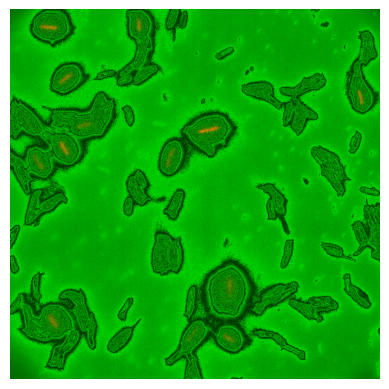

In [ ]:
convert_nd2_first_frame_to_3channel_png('/content/drive/MyDrive/Colab Notebooks/Data/ND2/01-19-24 FH Chp B R1--1.nd2','/content/drive/MyDrive/Colab Notebooks/Test' )

In [ ]:
process_csv('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/20mins021.csv')

Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/Data/CSV2/20mins021.txt


In [ ]:
!rm Img1.txt
process_csv('Img1.csv')
!head Img1.txt

1 0.46696628397681367 0.34465487554716645 0.42285281111375844 0.3722200327064284 0.41596152182394297 0.36119166449066453 0.4600749946869982 0.3336265073314027
1 0.6062602391636375 0.6770419829666053 0.5695997844781431 0.6636986691181505 0.5736432129170688 0.6525894404255763 0.6103036676025632 0.6659327542740312
1 0.5365974298306756 0.6644164431853606 0.5033823352849519 0.6489279899492278 0.5083786105224141 0.638213443321575 0.5415937050681378 0.6537018965577079
1 0.5589466188286102 0.7593881491632024 0.5089550897120269 0.7411927211880366 0.5134028609948451 0.7289725696262052 0.5633943901114283 0.747167997601371
1 0.5761221819652332 0.8350254761358828 0.5426412216897091 0.7921718021683524 0.5538204409855865 0.7834376386182155 0.5873014012611107 0.8262913125857461
1 0.5636785435330897 0.9035961978347883 0.547972929721817 0.8665960799738216 0.5599435560886002 0.8615148519760568 0.5756491698998729 0.8985149698370235
1 0.5486932975336333 0.8675653613729248 0.5355595420529481 0.8333507569429

# Using sliders for showing images

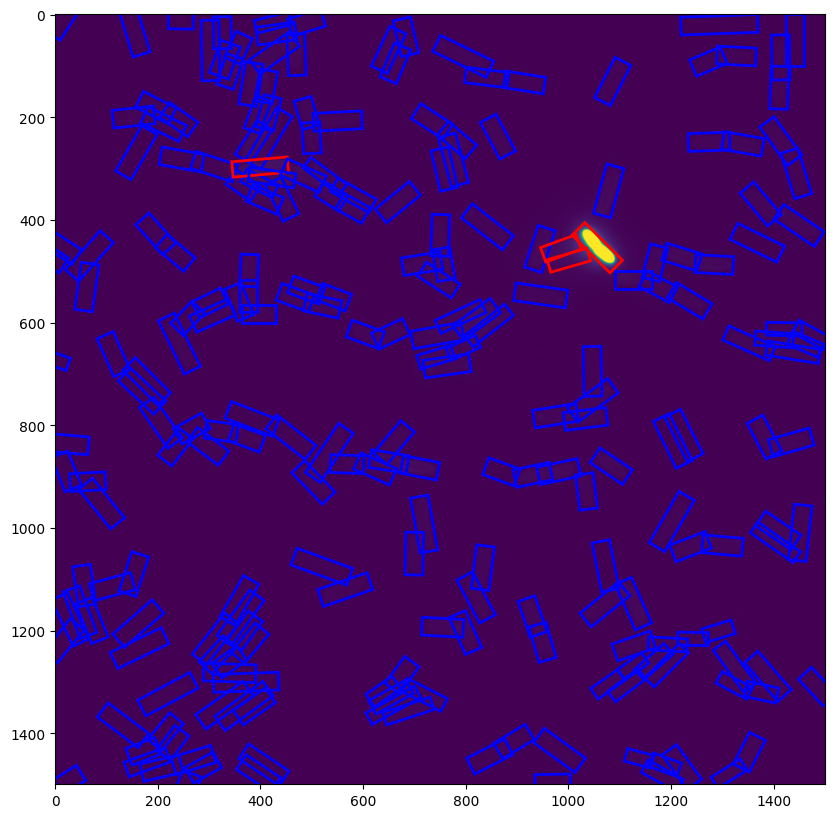

In [ ]:
import matplotlib.patches as patches

# Create a sample image
img = nd2.imread('/content/drive/MyDrive/Colab Notebooks/Data/ND2/20mins021.nd2')[0]
height, width = img.shape[:2]

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)

for _, box in nrm_df.iterrows():
    # Scale the coordinates to image dimensions
    corners = [[box.x1 * width, box.y1 * height],
              [box.x2 * width, box.y2 * height],
              [box.x3 * width, box.y3 * height],
              [box.x4 * width, box.y4 * height]]

    polygon = patches.Polygon(corners, fill=False,
                            edgecolor='r' if box.class_index == 1 else 'b',
                            linewidth=2)
    ax.add_patch(polygon)

plt.show()

# Clahe Apply on Images

In [ ]:
import nd2
import matplotlib.pyplot as plt

def get_im(file_path):
  """Reads an image file using nd2.imread and returns the first frame."""
  return nd2.imread(file_path)[0]

def show_image(image):
  """Displays an image using matplotlib.pyplot.imshow."""
  plt.imshow(image)
  plt.show()

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def apply_clahe(image_path):
    """ Apply CLAHE (Contrast Limited Adaptive Histogram Equalization) to an image """
    # Read the image in grayscale
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise ValueError(f"Error: Could not read the image at {image_path}")

    # Save the original image for comparison
    original_image = image.copy()

    # Normalize if necessary
    if image.dtype != np.uint8:
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Apply CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(image)

    # Compare original and enhanced images
    compare_ims(original_image, enhanced)

    # Save the modified image, replacing the original file
    cv2.imwrite(image_path, enhanced)
    print(f"Enhanced image saved at: {image_path}")

    return enhanced  # Return the processed image

def compare_ims(img1, img2):
    """ Display a side-by-side comparison of two images """
    plt.figure(figsize=(12,6))

    # Original image
    plt.subplot(121)
    plt.imshow(img1, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    # CLAHE-enhanced image
    plt.subplot(122)
    plt.imshow(img2, cmap='gray')
    plt.title('CLAHE-Enhanced Image')
    plt.axis('off')

    plt.show()


In [ ]:
def compare_ims(img1, img2):
    plt.figure(figsize=(12,6))
    plt.subplot(121)
    plt.imshow(img1, cmap='gray')
    plt.title('img1')
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(img2, cmap='gray')
    plt.title('img2')
    plt.axis('off')

    plt.show()

# *Convert nd2 to PNG*

In [ ]:
import numpy as np
from nd2 import ND2File
from PIL import Image
from pathlib import Path

def convert_nd2_to_png(nd2_path, output=None):
    with ND2File(nd2_path) as image:
        frame = image.read_frame(0)  # Read the first frame

        # Normalize if the image is 16-bit or higher
        if frame.dtype != np.uint8:
            frame = (frame / frame.max() * 255).astype(np.uint8)

        img = Image.fromarray(frame)

        # Ensure output path
        output_path = Path(nd2_path).with_suffix('.png') if output is None else Path(output)
        img.save(output_path, format='PNG')



In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from nd2reader import ND2Reader
from pathlib import Path

def gamma_correction(image_path, gamma=7):
    """ Load an image from a file and apply gamma correction to enhance fluorescence images """
    if gamma is None:
      gamma = 7
    # Convert PosixPath to string
    image_path = str(image_path)

    # Load the image from the ND2 file
    with ND2Reader(image_path) as nd2:
        nd2.iter_axes = 't'  # Process time-series
        image = nd2.get_frame(0)  # Get the first frame

    # Save the original image for comparison
    original_image = np.uint8(image)

    # Apply gamma correction
    image = image.astype(np.float32)  # Convert to float for precision
    image = image / np.max(image)  # Normalize to [0, 1] range
    image = np.power(image, 1/gamma)  # Apply gamma correction
    corrected_image = np.uint8(image * 255)  # Convert back to 8-bit

    # Compare original and corrected images
    compare_ims(original_image, corrected_image)

    # Save the gamma-corrected image with the same name but as PNG
    output_path = Path(image_path).with_suffix(".png")
    cv2.imwrite(str(output_path), corrected_image)
    print(f"Gamma-corrected image saved at: {output_path}")

    return corrected_image  # Return the gamma-corrected image

def compare_ims(img1, img2):
    """ Display a side-by-side comparison of two images """
    plt.figure(figsize=(12,6))

    # Original image
    plt.subplot(121)
    plt.imshow(img1, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    # Gamma-corrected image
    plt.subplot(122)
    plt.imshow(img2, cmap='gray')
    plt.title('Gamma-Corrected Image')
    plt.axis('off')

    # Show the comparison
    plt.show()


# YOLO Folders

In [ ]:
from pathlib import Path

data_dir = '/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2'
# os.chdir(current_dir)
# print(f"Current directory: {current_dir}")
# !ls

In [ ]:
def find_files(dir, ext="nd2"):
    dir = Path(dir)
    files = list(dir.glob(f"**/*.{ext}"))
    return files

In [ ]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2')

In [ ]:
def process_files(dir, input_ext="nd2", output_ext="png", process=None, output_path=None):
    input_files = find_files(dir, ext=input_ext)
    for input_file in input_files:
        output_file = input_file.with_suffix(f".{output_ext}")
        print(f"Converting {input_file.name} to {output_file.name}")
        if process: process(input_file)

In [ ]:
find_files(data_dir, ext="nd2")

[PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/dCpdA R1 FH 017.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/WT-A86C-LB-ice-002.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/Chp B Replicate 2 200 MS060.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/200ms-0.4%-005.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/20mins021.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/4hrs incu004.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/1hr01002.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-24-24 FH  CyaB R1005.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-19-24 FH Chp B R1.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0N01002.nd2'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0.1%.004.nd2'),
 Po

In [ ]:
find_files(data_dir, ext="csv")

[PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV/1hr01002.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV/0.1%.004.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV/WT-A86C-LB-ice-003.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/01-24-24 FH  CyaB R1005.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/0N01002.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/01-19-24 FH Chp B R1.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/WT-A86C-LB-ice-002.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/200ms-0.4%-005.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/1hr01002.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/0.1%.004.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/20mins021.csv'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/Data/CSV2/4hrs incu004.csv'),
 PosixPath('/content/d

Converting dCpdA R1 FH 017.nd2 to dCpdA R1 FH 017.png


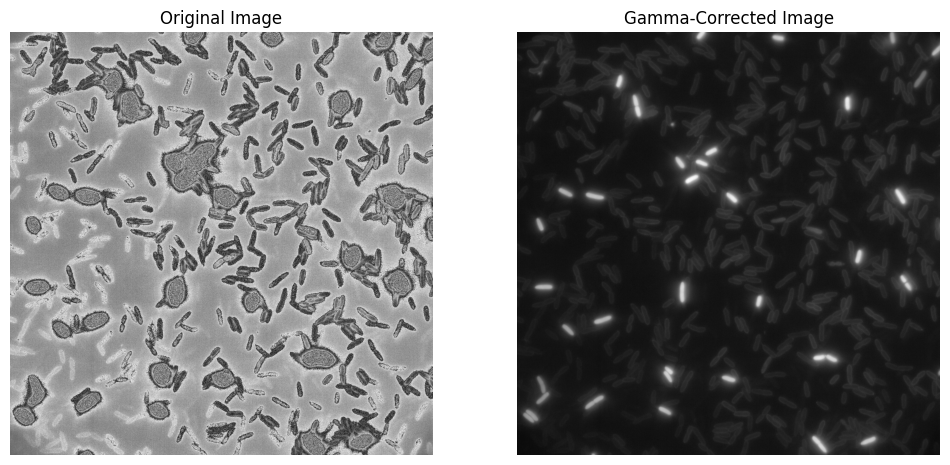

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/dCpdA R1 FH 017.png
Converting WT-A86C-LB-ice-002.nd2 to WT-A86C-LB-ice-002.png


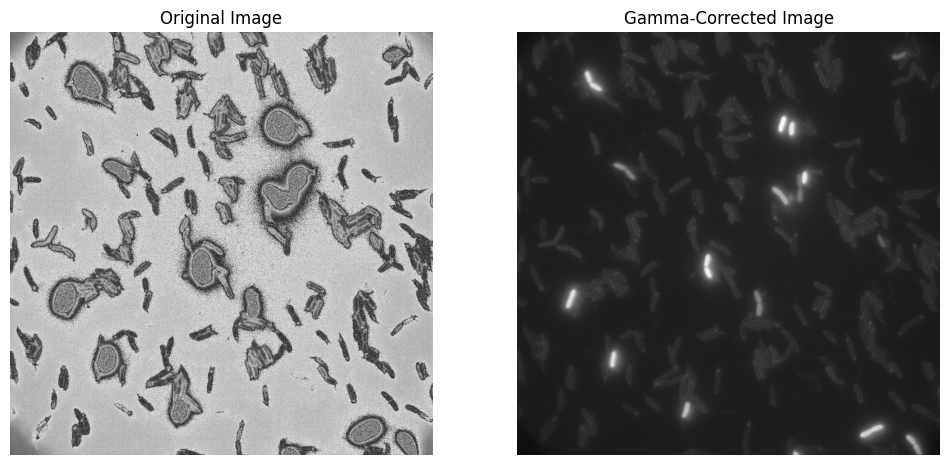

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/WT-A86C-LB-ice-002.png
Converting Chp B Replicate 2 200 MS060.nd2 to Chp B Replicate 2 200 MS060.png


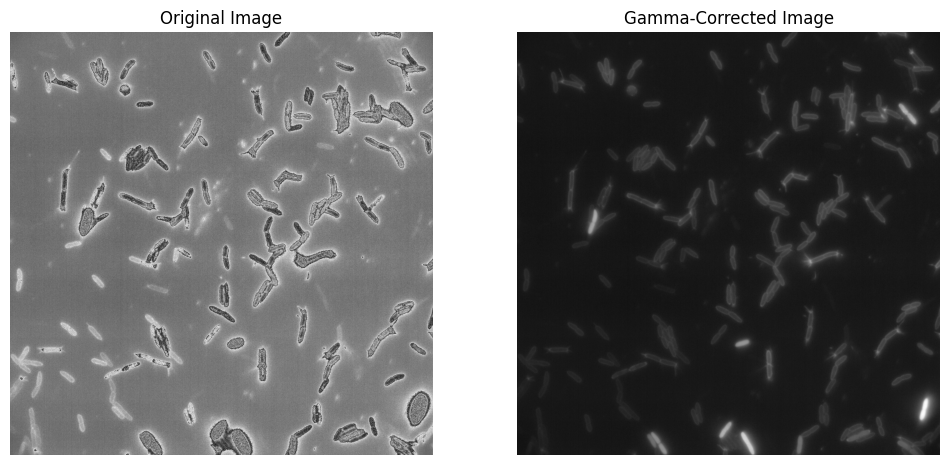

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/Chp B Replicate 2 200 MS060.png
Converting 200ms-0.4%-005.nd2 to 200ms-0.4%-005.png


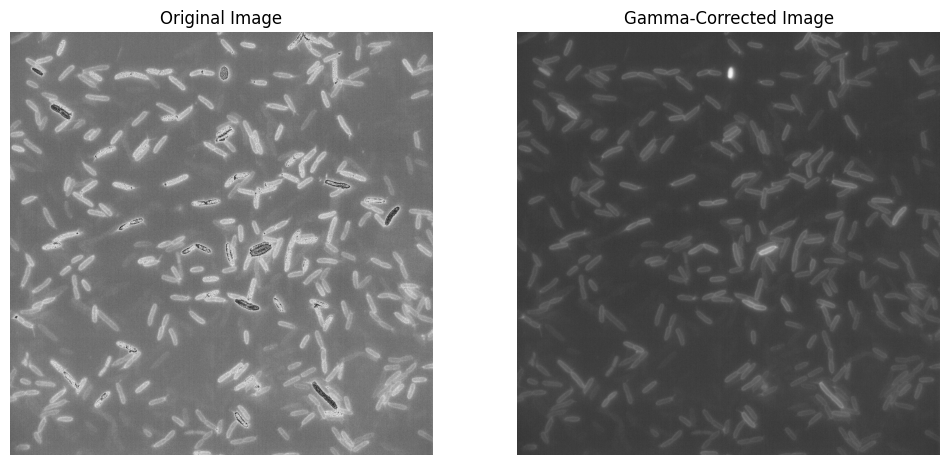

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/200ms-0.4%-005.png
Converting 20mins021.nd2 to 20mins021.png


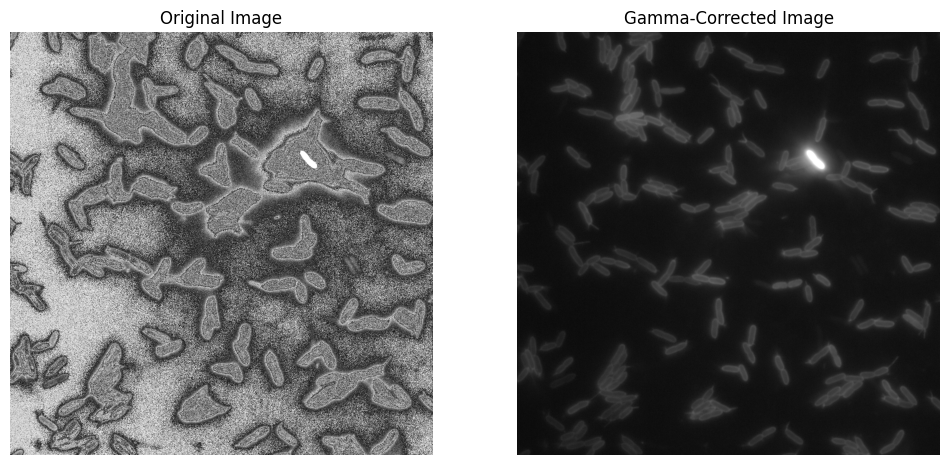

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/20mins021.png
Converting 4hrs incu004.nd2 to 4hrs incu004.png


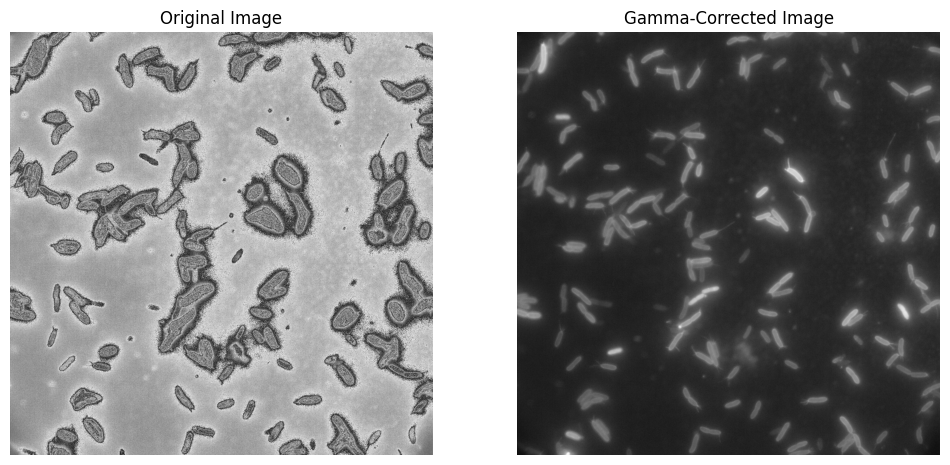

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/4hrs incu004.png
Converting 1hr01002.nd2 to 1hr01002.png


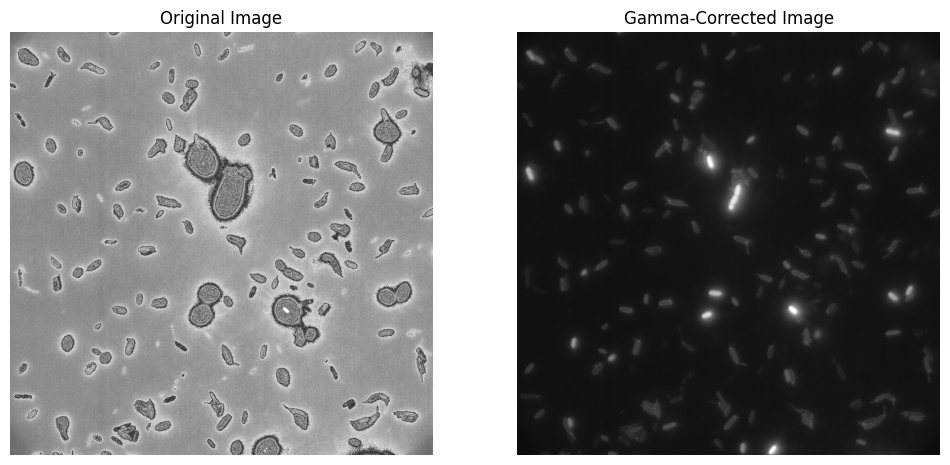

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/1hr01002.png
Converting 01-24-24 FH  CyaB R1005.nd2 to 01-24-24 FH  CyaB R1005.png


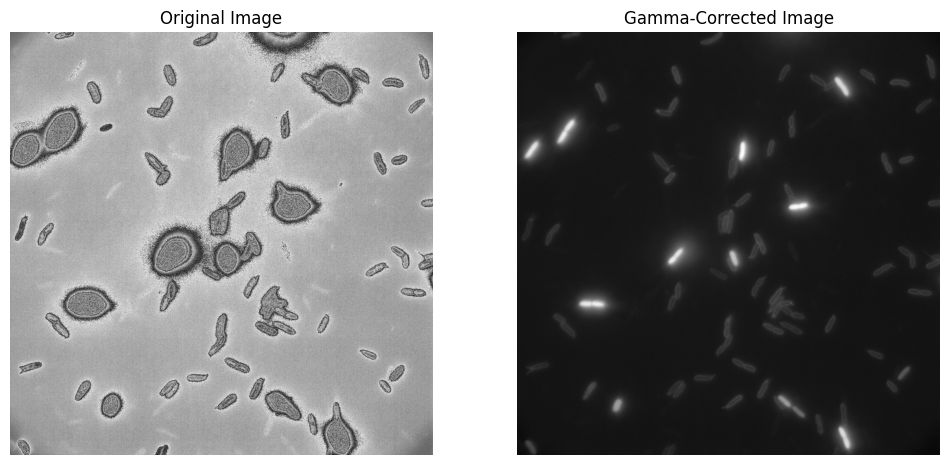

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-24-24 FH  CyaB R1005.png
Converting 01-19-24 FH Chp B R1.nd2 to 01-19-24 FH Chp B R1.png


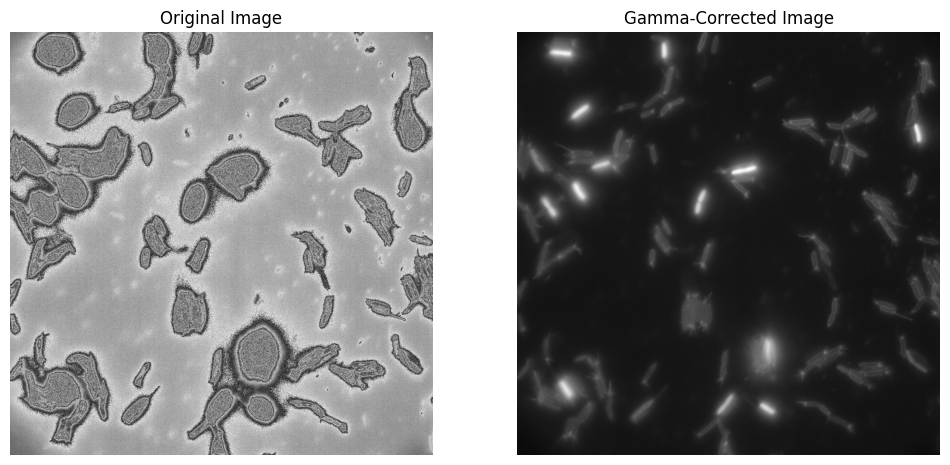

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-19-24 FH Chp B R1.png
Converting 0N01002.nd2 to 0N01002.png


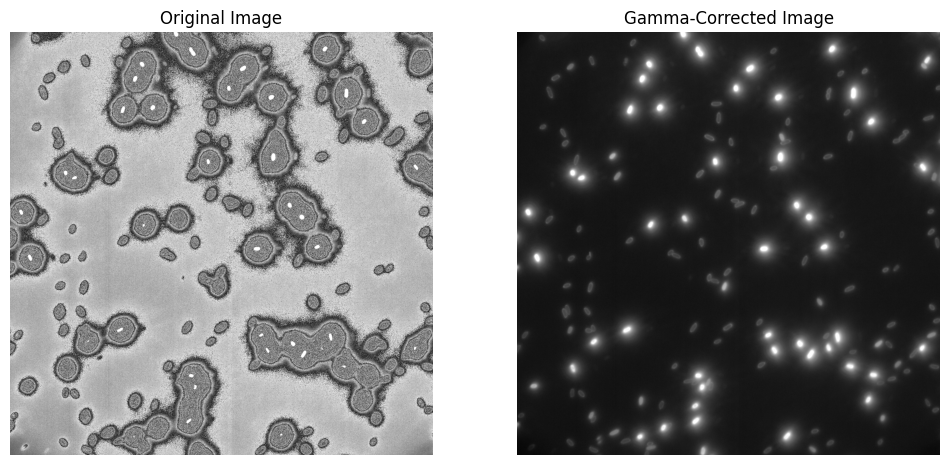

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0N01002.png
Converting 0.1%.004.nd2 to 0.1%.004.png


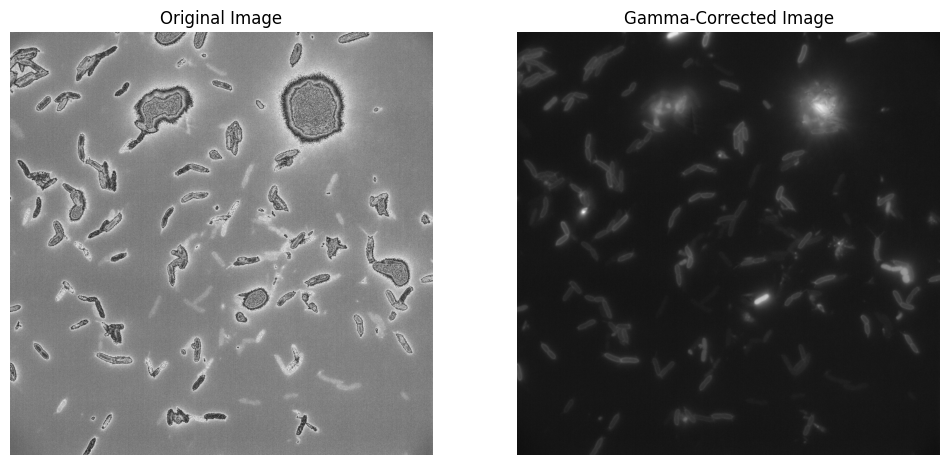

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0.1%.004.png
Converting WT-A86C-LB-ice-003.nd2 to WT-A86C-LB-ice-003.png


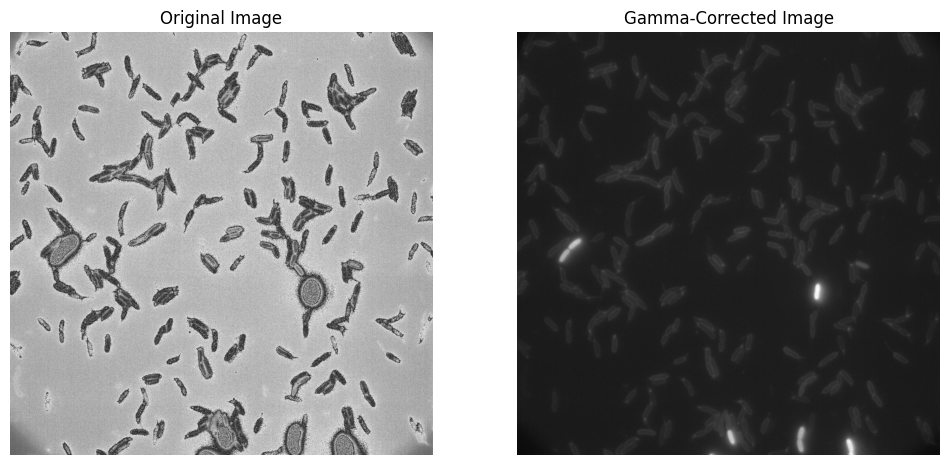

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/WT-A86C-LB-ice-003.png
Converting Pil B 200 MS R2nd2135.nd2 to Pil B 200 MS R2nd2135.png


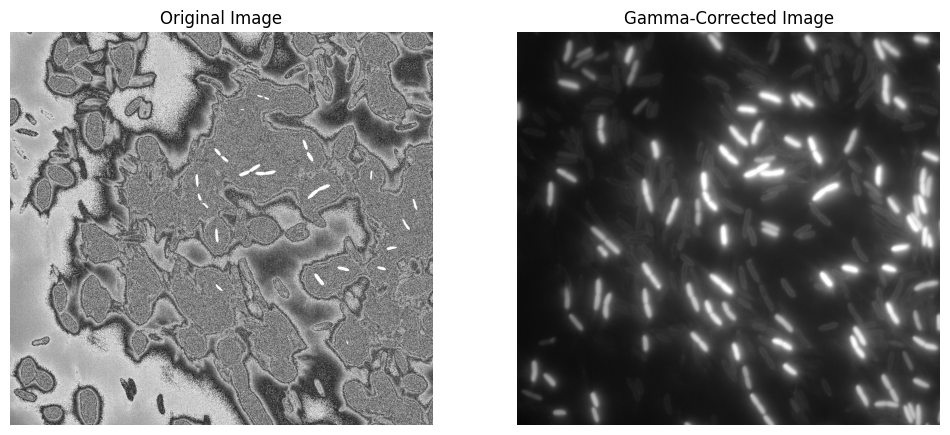

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/Pil B 200 MS R2nd2135.png
Converting dPilG FH R1001.nd2 to dPilG FH R1001.png


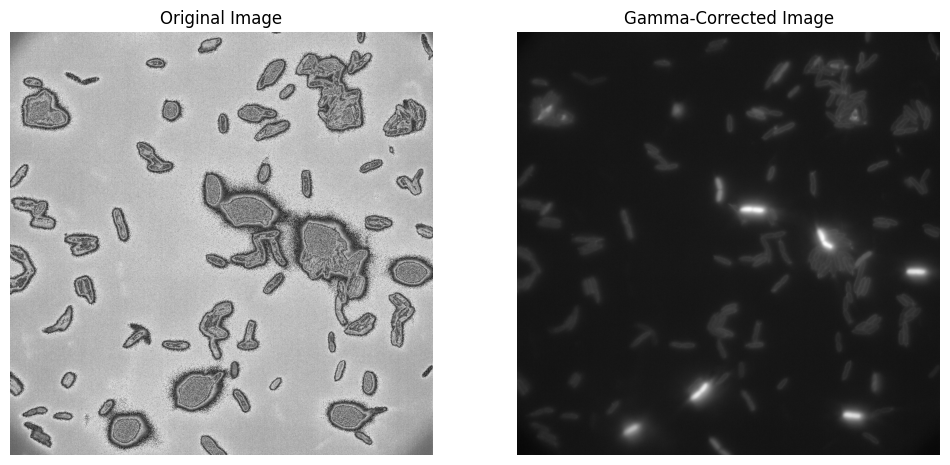

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/dPilG FH R1001.png
Converting 200ms-0.1%-003.nd2 to 200ms-0.1%-003.png


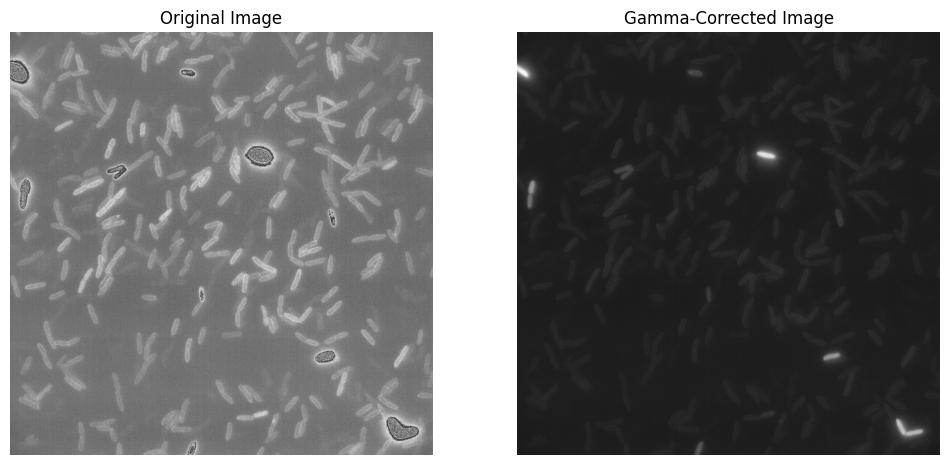

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/200ms-0.1%-003.png
Converting 83 1.0 ul tet001.nd2 to 83 1.0 ul tet001.png


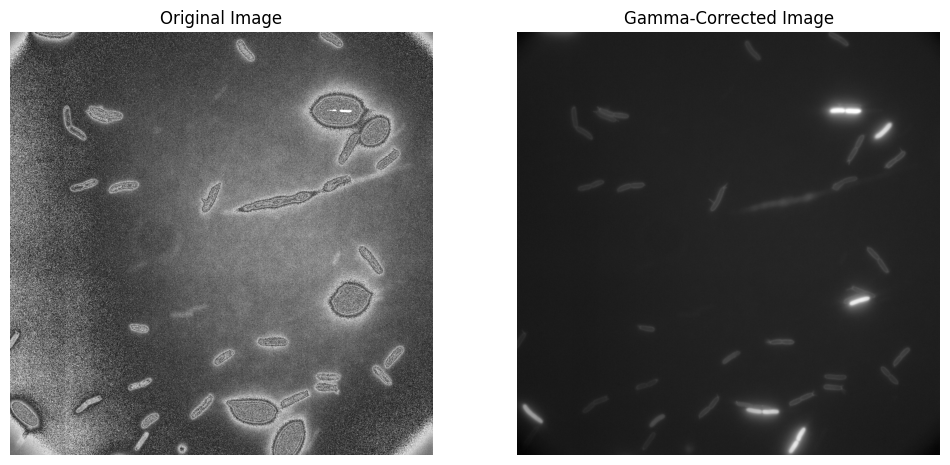

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/83 1.0 ul tet001.png
Converting 7.1- 003.nd2 to 7.1- 003.png


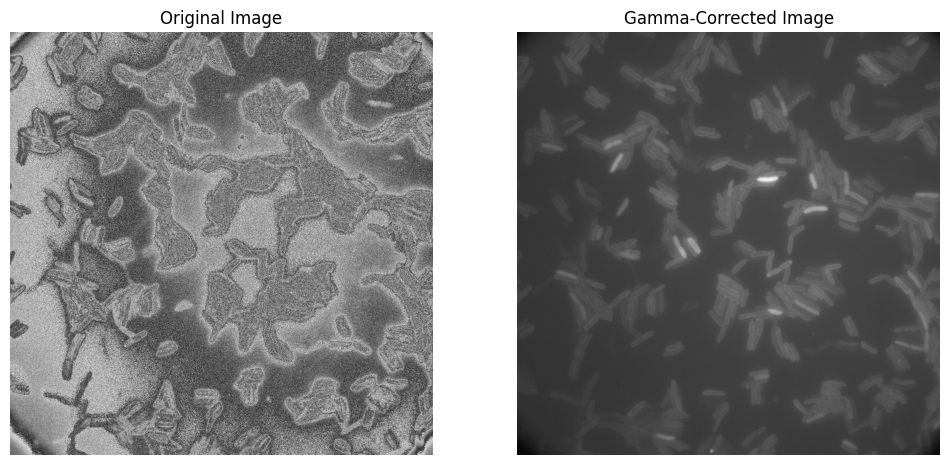

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/7.1- 003.png
Converting 0.3-001.nd2 to 0.3-001.png


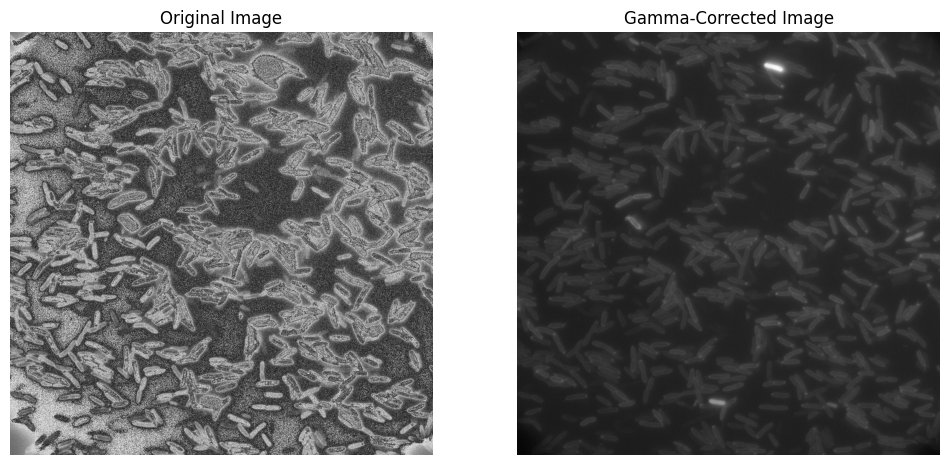

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0.3-001.png


In [ ]:
process_files(data_dir, input_ext="nd2", output_ext="png", process=gamma_correction)

Converting dCpdA R1 FH 017.png to dCpdA R1 FH 017.png


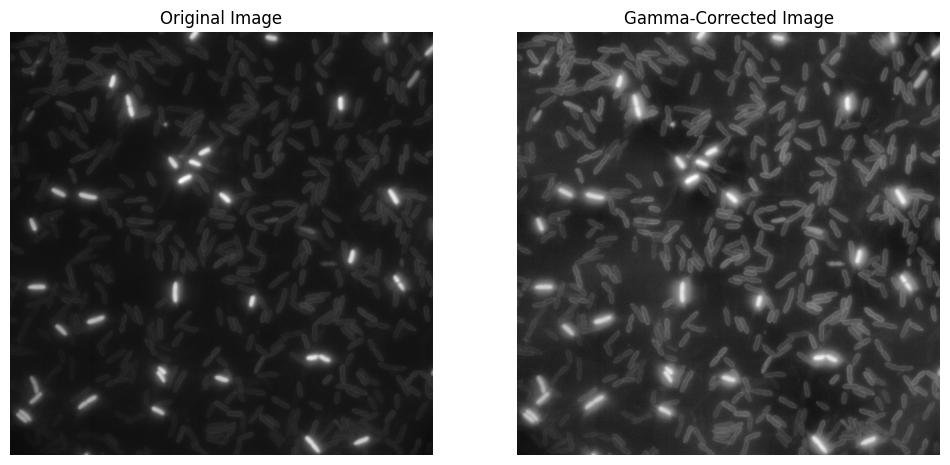

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/dCpdA R1 FH 017.png
Converting WT-A86C-LB-ice-002.png to WT-A86C-LB-ice-002.png


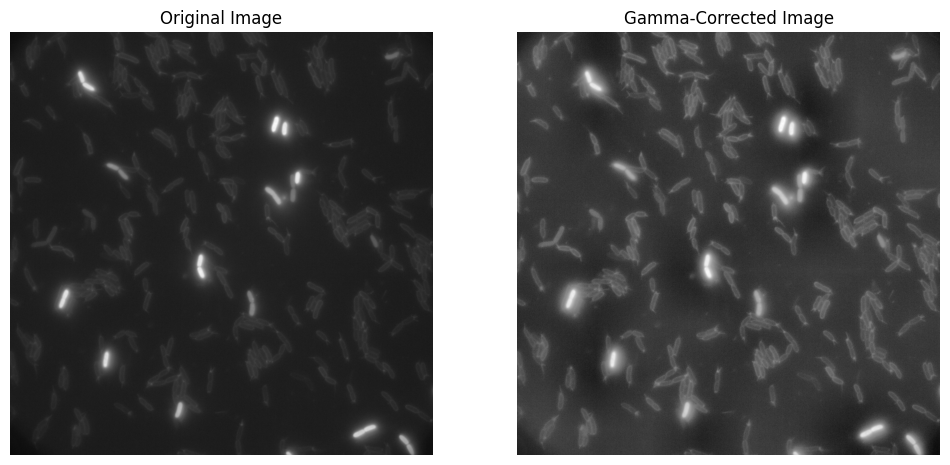

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/WT-A86C-LB-ice-002.png
Converting Chp B Replicate 2 200 MS060.png to Chp B Replicate 2 200 MS060.png


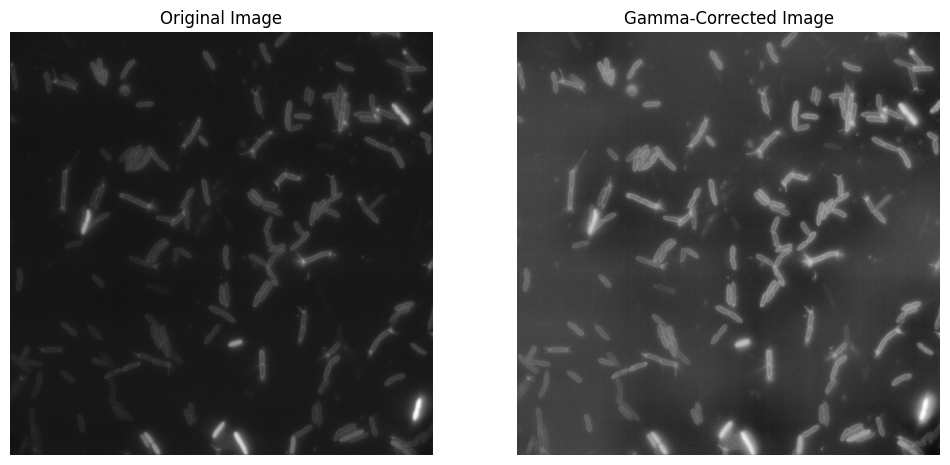

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/Chp B Replicate 2 200 MS060.png
Converting 200ms-0.4%-005.png to 200ms-0.4%-005.png


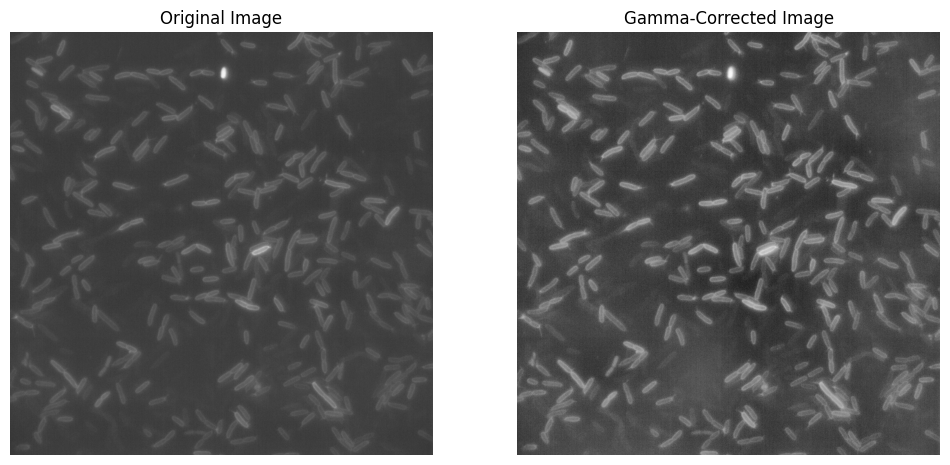

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/200ms-0.4%-005.png
Converting 20mins021.png to 20mins021.png


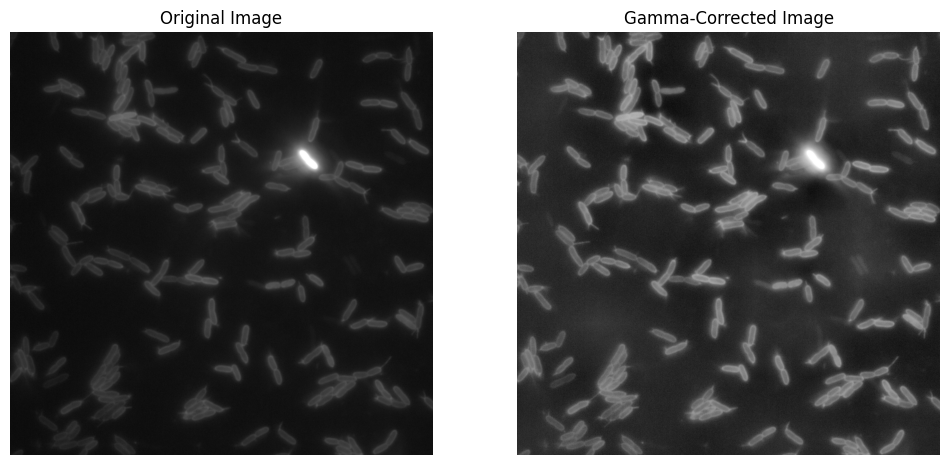

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/20mins021.png
Converting 4hrs incu004.png to 4hrs incu004.png


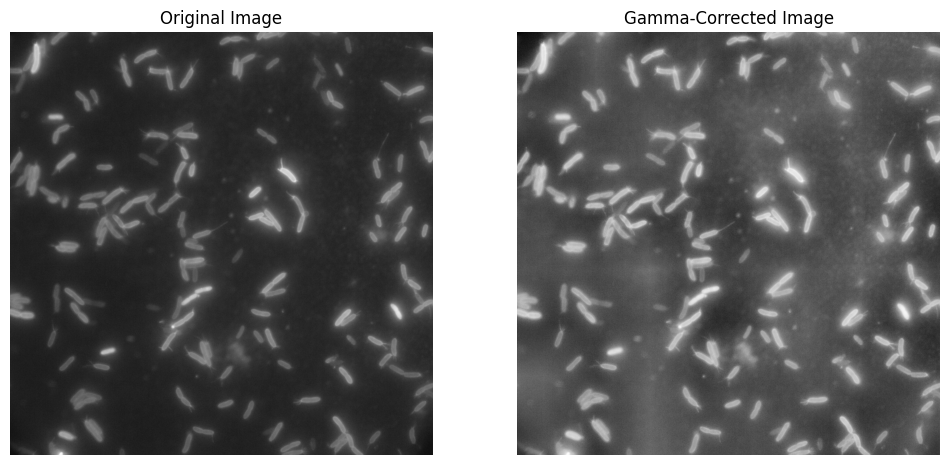

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/4hrs incu004.png
Converting 1hr01002.png to 1hr01002.png


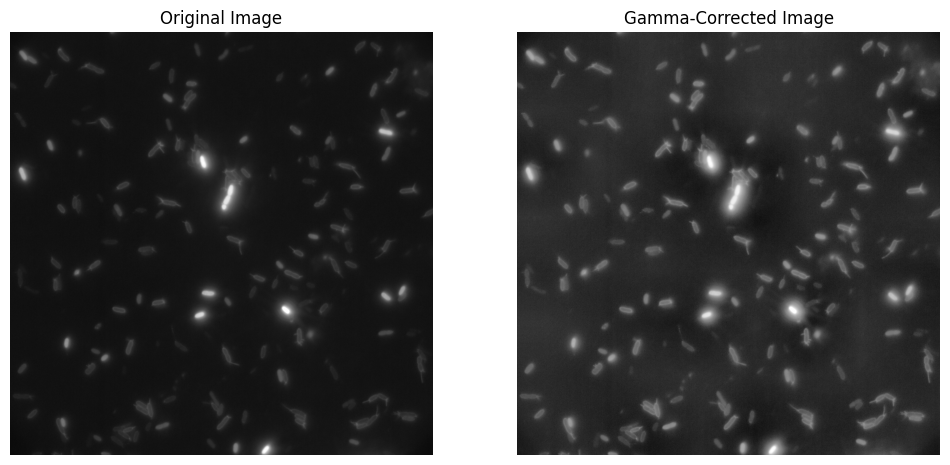

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/1hr01002.png
Converting 01-24-24 FH  CyaB R1005.png to 01-24-24 FH  CyaB R1005.png


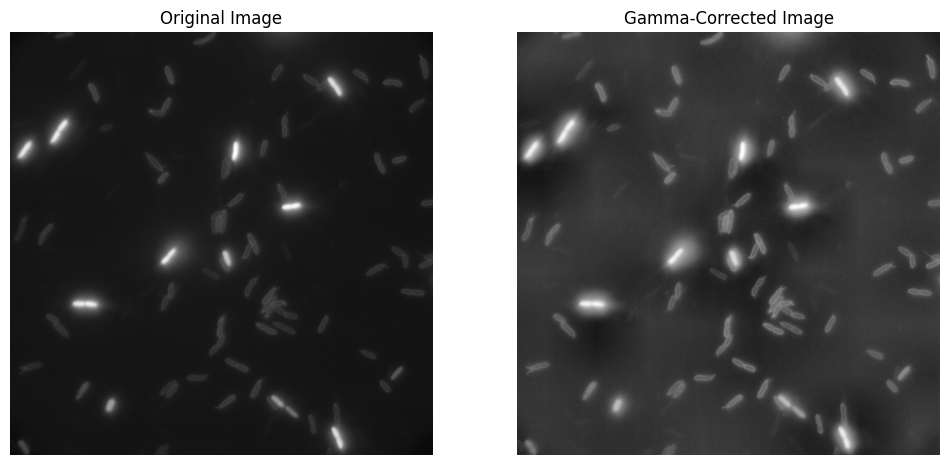

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-24-24 FH  CyaB R1005.png
Converting 01-19-24 FH Chp B R1.png to 01-19-24 FH Chp B R1.png


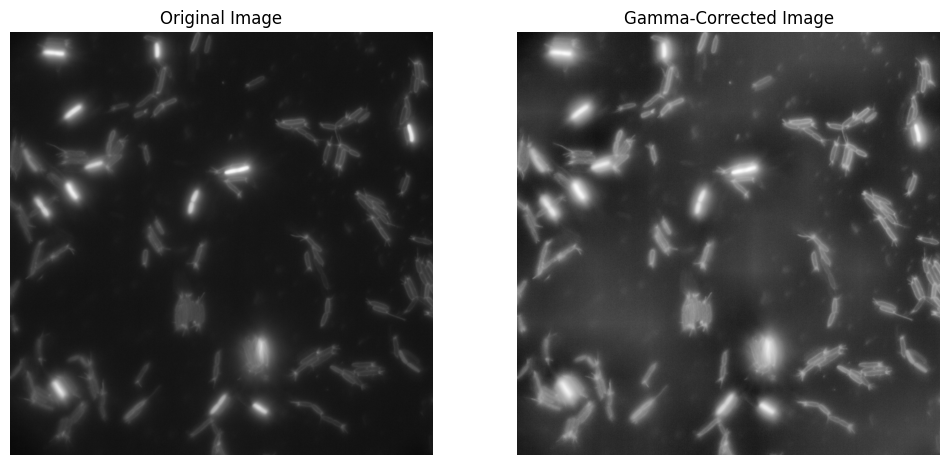

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/01-19-24 FH Chp B R1.png
Converting 0N01002.png to 0N01002.png


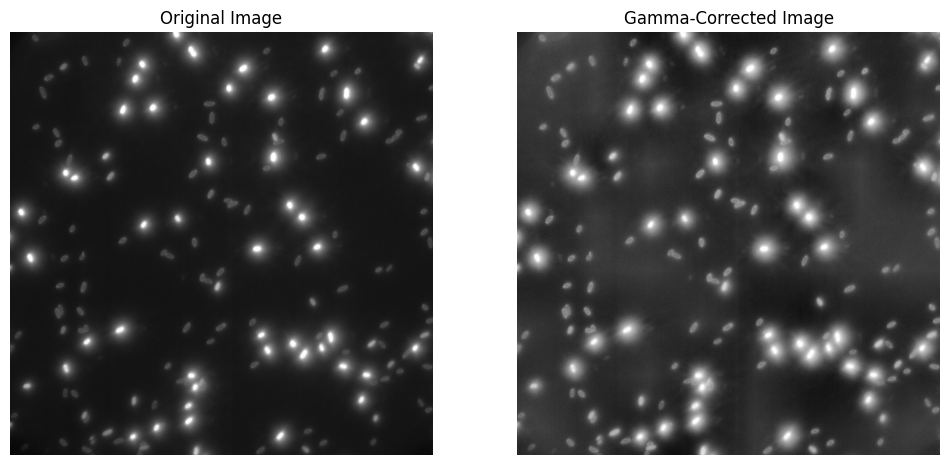

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0N01002.png
Converting 0.1%.004.png to 0.1%.004.png


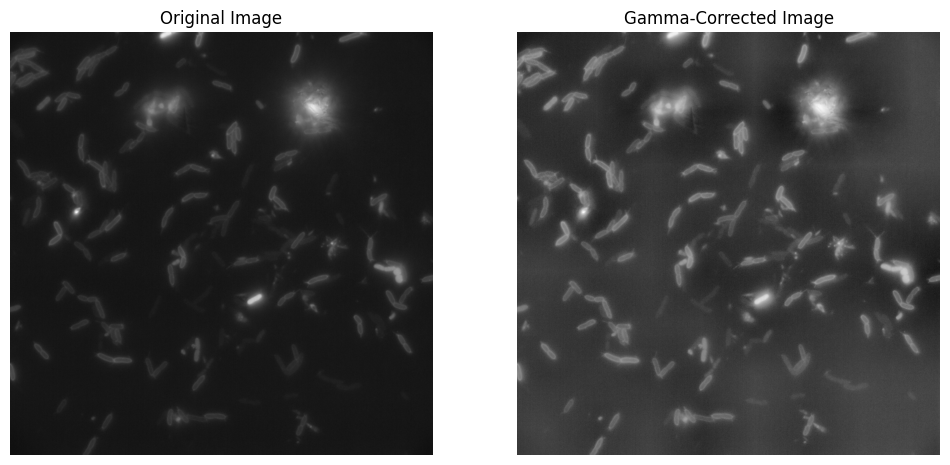

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0.1%.004.png
Converting WT-A86C-LB-ice-003.png to WT-A86C-LB-ice-003.png


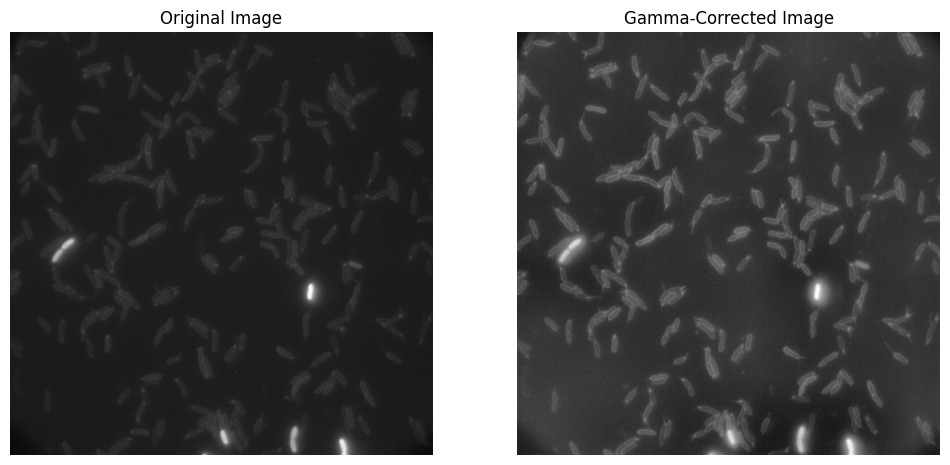

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/WT-A86C-LB-ice-003.png
Converting Pil B 200 MS R2nd2135.png to Pil B 200 MS R2nd2135.png


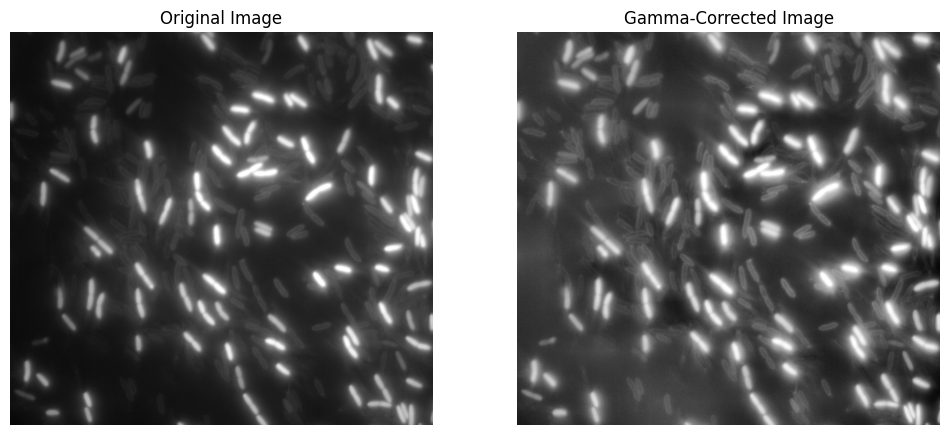

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/Pil B 200 MS R2nd2135.png
Converting dPilG FH R1001.png to dPilG FH R1001.png


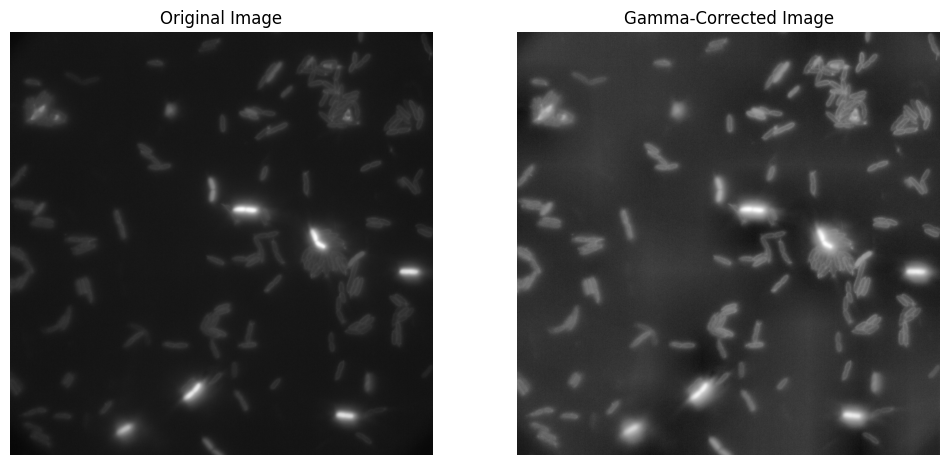

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/dPilG FH R1001.png
Converting 200ms-0.1%-003.png to 200ms-0.1%-003.png


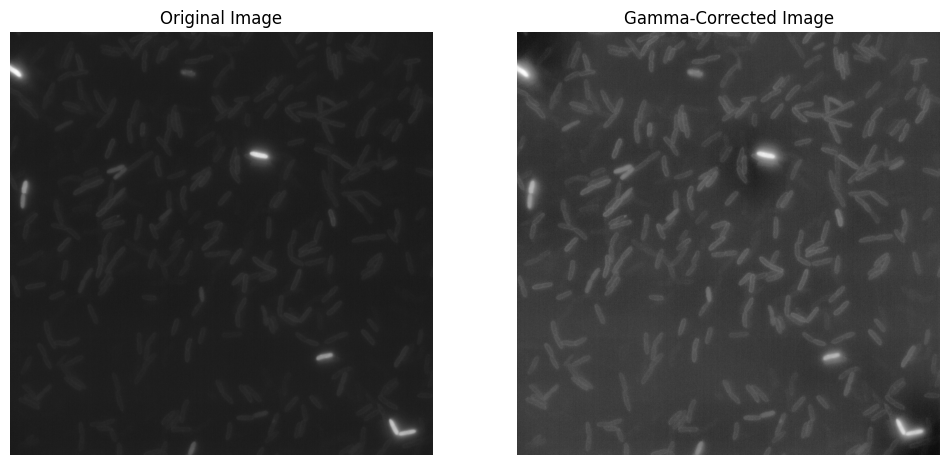

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/200ms-0.1%-003.png
Converting 83 1.0 ul tet001.png to 83 1.0 ul tet001.png


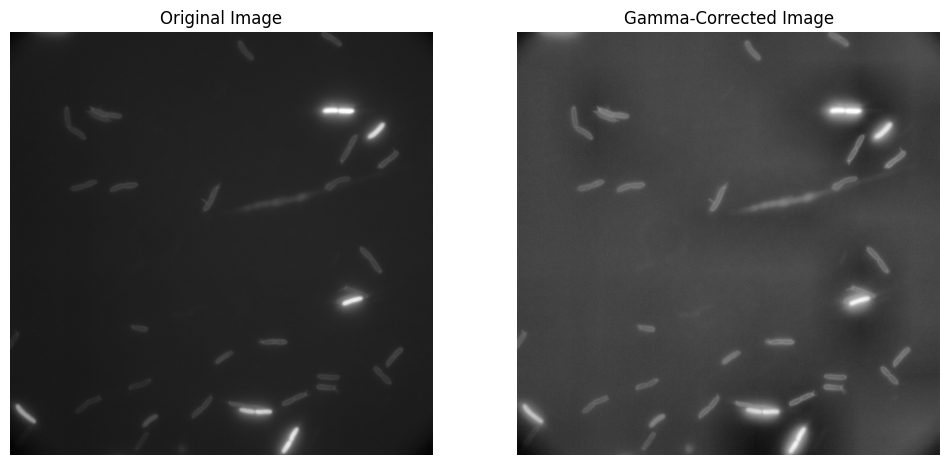

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/83 1.0 ul tet001.png
Converting 7.1- 003.png to 7.1- 003.png


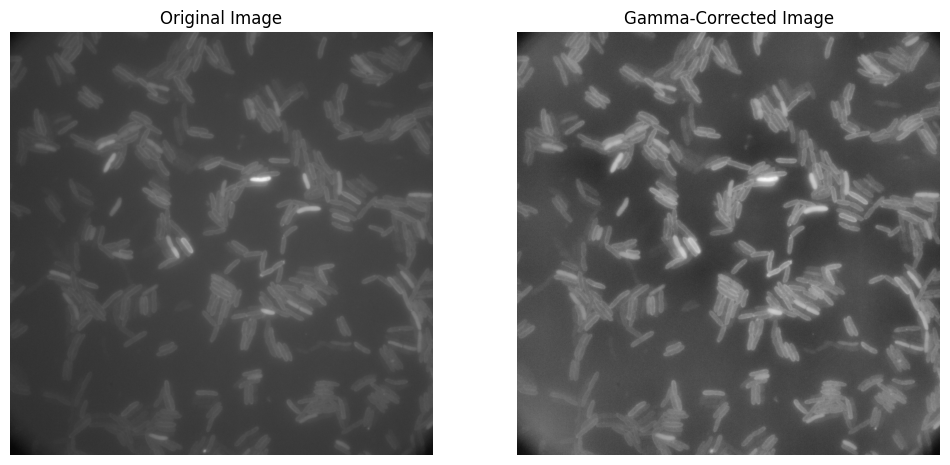

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/7.1- 003.png
Converting 0.3-001.png to 0.3-001.png


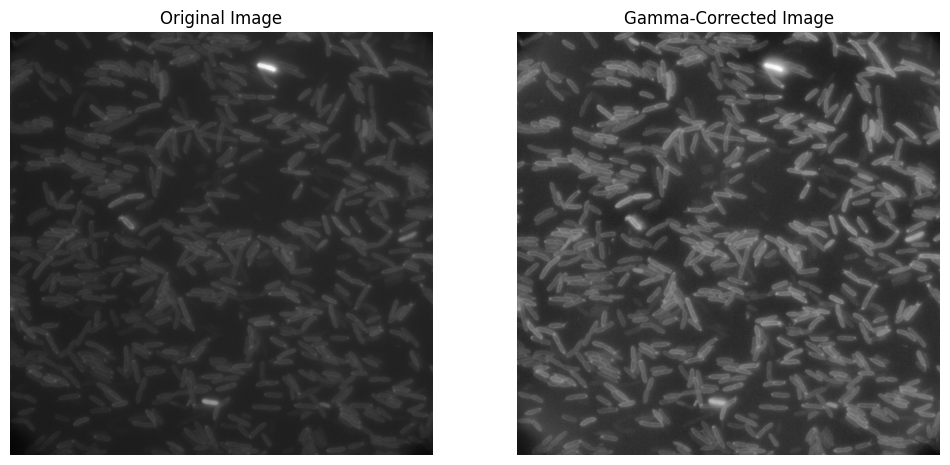

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Slicing_Data/ND2/0.3-001.png


In [ ]:
process_files(data_dir, input_ext="png", output_ext="png", process=apply_clahe)

In [ ]:
process_files(data_dir, input_ext="csv", output_ext="txt", process=process_csv)

Converting 7.1- 003.csv to 7.1- 003.txt
Converting 20mins021.csv to 20mins021.txt
Converting 4hrs incu004.csv to 4hrs incu004.txt
Converting 1hr01002.csv to 1hr01002.txt
Converting 0.1%.004.csv to 0.1%.004.txt
Converting dCpdA R1 FH 017.csv to dCpdA R1 FH 017.txt
Converting 1-004.csv to 1-004.txt
Converting Chp B Replicate 2 200 MS060.csv to Chp B Replicate 2 200 MS060.txt
Converting WT-A86C-LB-ice-003.csv to WT-A86C-LB-ice-003.txt
Converting 200ms-0.1%-003.csv to 200ms-0.1%-003.txt
Converting 0.3-004.csv to 0.3-004.txt


In [ ]:
find_files(data_dir, ext="txt")

[]

Converting 0.1%.004.nd2 to 0.1%.004.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/0.1%.004.png


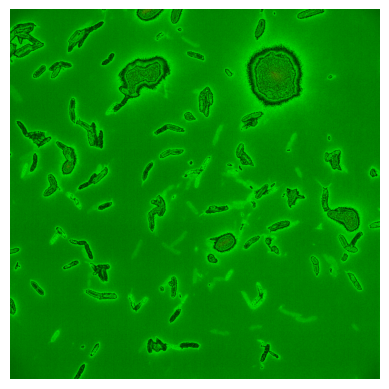

Converting 4hrs incu004.nd2 to 4hrs incu004.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/4hrs incu004.png


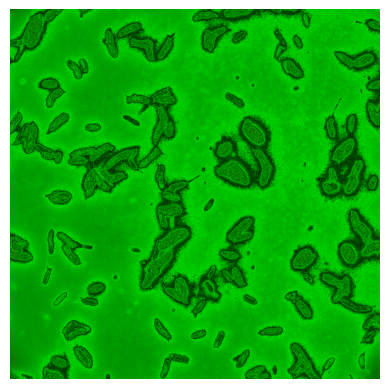

Converting WT-A86C-LB-ice-002.nd2 to WT-A86C-LB-ice-002.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/WT-A86C-LB-ice-002.png


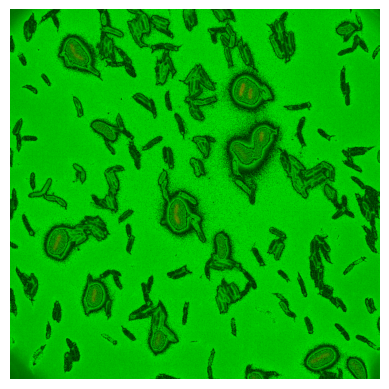

Converting 200ms-0.4%-005.nd2 to 200ms-0.4%-005.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/200ms-0.4%-005.png


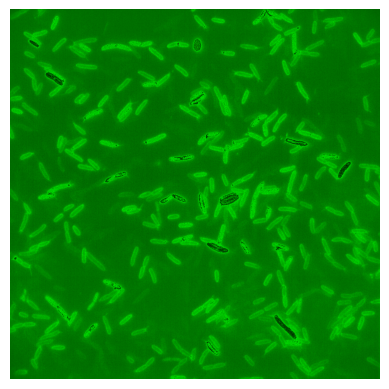

Converting 0N01002.nd2 to 0N01002.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/0N01002.png


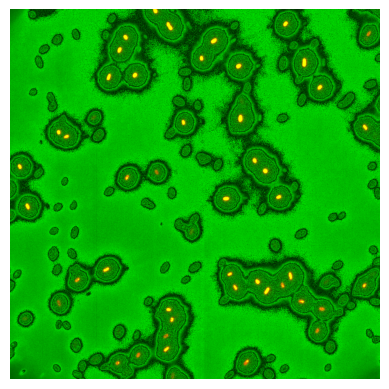

Converting 1hr01002.nd2 to 1hr01002.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/1hr01002.png


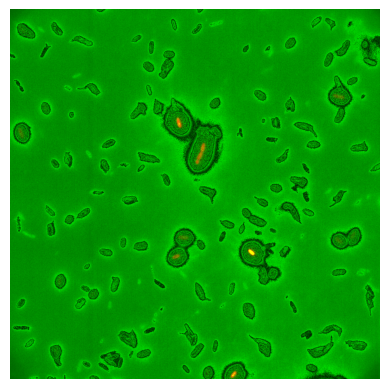

Converting Chp B Replicate 2 200 MS060.nd2 to Chp B Replicate 2 200 MS060.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/Chp B Replicate 2 200 MS060.png


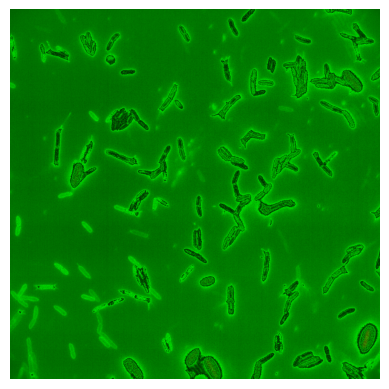

Converting dCpdA R1 FH 017.nd2 to dCpdA R1 FH 017.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/dCpdA R1 FH 017.png


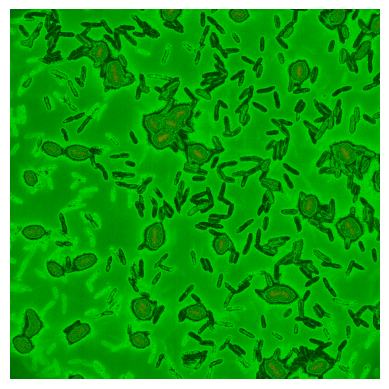

Converting 20mins021.nd2 to 20mins021.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/20mins021.png


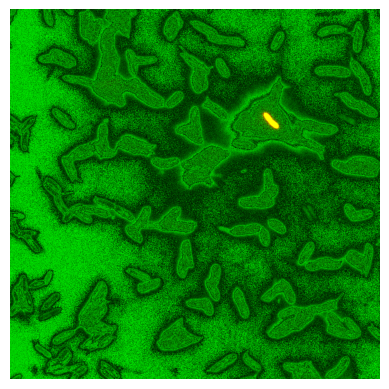

Converting 01-19-24 FH Chp B R1.nd2 to 01-19-24 FH Chp B R1.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/01-19-24 FH Chp B R1.png


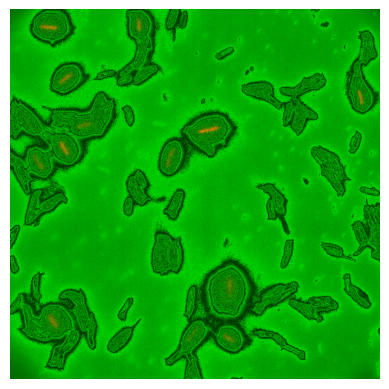

Converting 01-24-24 FH  CyaB R1005.nd2 to 01-24-24 FH  CyaB R1005.png
Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/images/01-24-24 FH  CyaB R1005.png


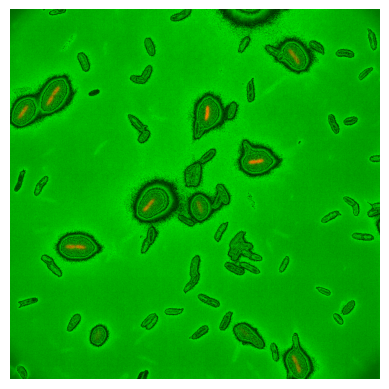

In [ ]:
process_files('/content/drive/MyDrive/Colab Notebooks/Data/ND2', process=convert_nd2_first_frame_to_3channel_png, output_ext="png", input_ext="nd2", output_path='/content/drive/MyDrive/Colab Notebooks/3channel_individual/images')

In [ ]:
process_files('/content/drive/MyDrive/Colab Notebooks/Data/CSV2', input_ext="csv", output_ext="txt", process=process_csv, output_path='/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels')

Converting 01-24-24 FH  CyaB R1005.csv to 01-24-24 FH  CyaB R1005.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/01-24-24 FH  CyaB R1005.txt
Converting 0N01002.csv to 0N01002.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/0N01002.txt
Converting 01-19-24 FH Chp B R1.csv to 01-19-24 FH Chp B R1.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/01-19-24 FH Chp B R1.txt
Converting WT-A86C-LB-ice-002.csv to WT-A86C-LB-ice-002.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/WT-A86C-LB-ice-002.txt
Converting 200ms-0.4%-005.csv to 200ms-0.4%-005.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/200ms-0.4%-005.txt
Converting 1hr01002.csv to 1hr01002.txt
Saved YOLO file to: /content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/1hr01002.txt
Converting 0.1%.004.csv to 0.1%.004.txt


In [ ]:
find_files('/content/drive/MyDrive/Colab Notebooks/3channel_individual', ext="png")

[PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/0.1%.004.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/4hrs incu004.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/WT-A86C-LB-ice-002.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/200ms-0.4%-005.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/0N01002.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/1hr01002.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/Chp B Replicate 2 200 MS060.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/dCpdA R1 FH 017.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/20mins021.png'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/images/01-19-24 FH Chp B R1.png'),
 P

In [ ]:
find_files('/content/drive/MyDrive/Colab Notebooks/3channel_individual', ext="txt")

[PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/01-24-24 FH  CyaB R1005.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/0N01002.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/01-19-24 FH Chp B R1.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/WT-A86C-LB-ice-002.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/200ms-0.4%-005.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/1hr01002.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/0.1%.004.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/20mins021.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/4hrs incu004.txt'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/3channel_individual/labels/dCpdA R1 FH 017.txt'),
 Posix

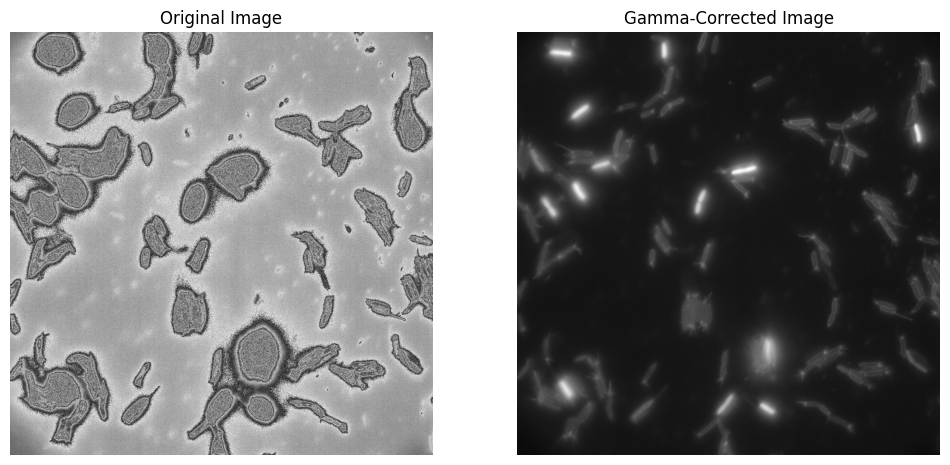

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Data/ND2/01-19-24 FH Chp B R1.png


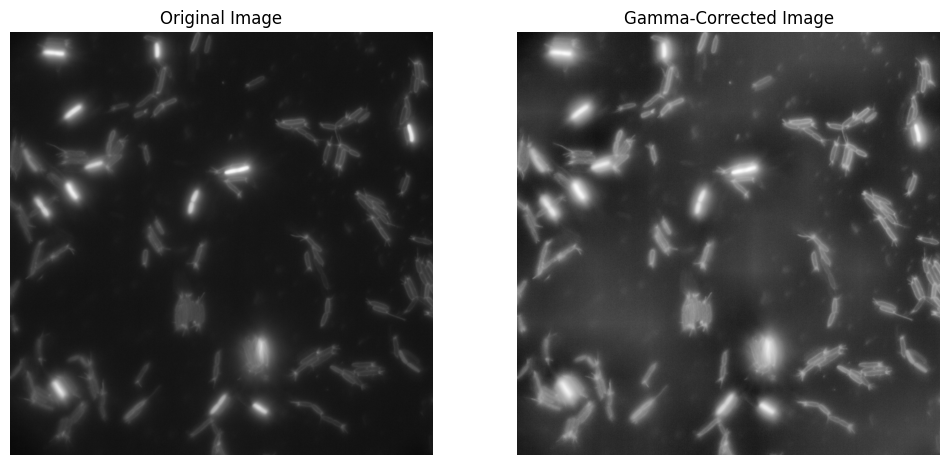

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Data/ND2/01-19-24 FH Chp B R1.png


array([[ 60,  65,  60, ...,  77,  79,  77],
       [ 58,  60,  60, ...,  82,  79,  87],
       [ 67,  62,  62, ...,  79,  77,  75],
       ...,
       [ 79,  77,  82, ..., 112, 103, 112],
       [ 74,  79,  79, ..., 109, 106, 106],
       [ 77,  79,  79, ..., 109, 115, 106]], dtype=uint8)

In [ ]:
gamma_correction('/content/drive/MyDrive/Colab Notebooks/Data/ND2/01-19-24 FH Chp B R1.nd2')
apply_clahe('/content/drive/MyDrive/Colab Notebooks/Data/ND2/01-19-24 FH Chp B R1.png')

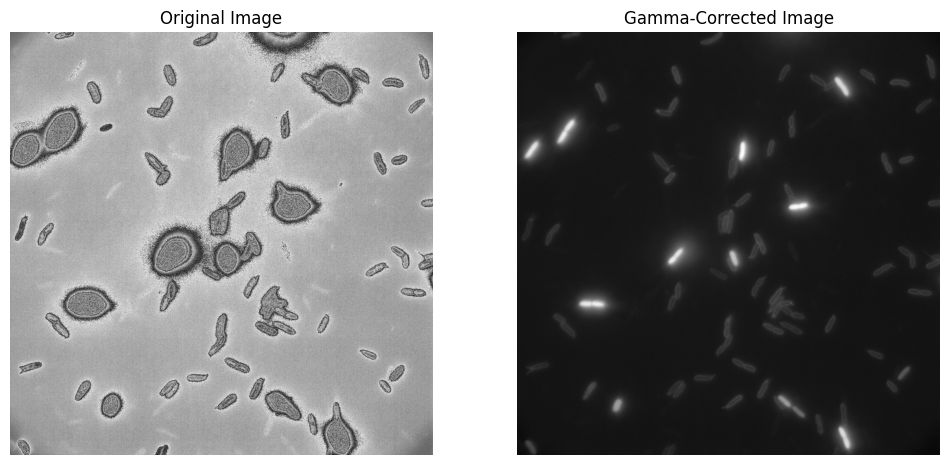

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Data/ND2/01-24-24 FH  CyaB R1005.png


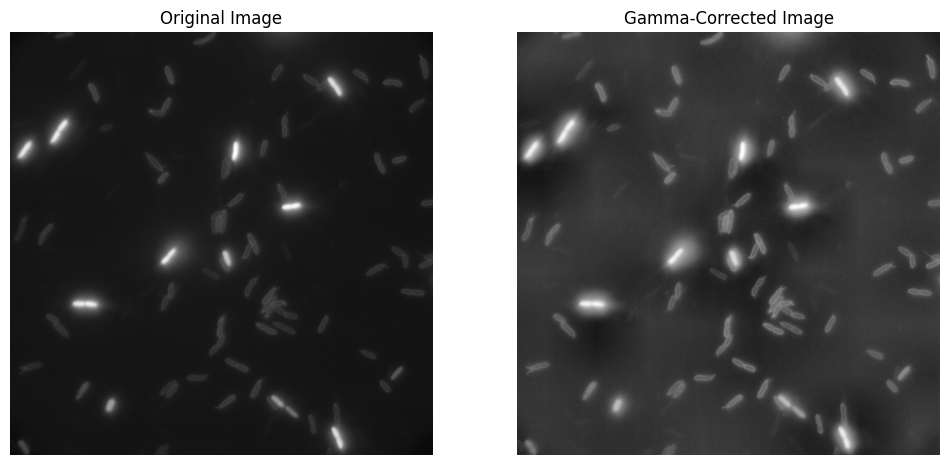

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Data/ND2/01-24-24 FH  CyaB R1005.png


array([[ 88,  97,  91, ...,  89,  83,  83],
       [ 91,  91,  87, ...,  91,  97,  86],
       [ 94,  91,  89, ...,  86,  83,  83],
       ...,
       [ 89,  92,  92, ..., 105, 102, 102],
       [ 92,  89,  97, ..., 102,  99, 102],
       [ 92,  89,  92, ...,  99, 102, 102]], dtype=uint8)

In [ ]:
gamma_correction('/content/drive/MyDrive/Colab Notebooks/Data/ND2/01-24-24 FH  CyaB R1005.nd2')
apply_clahe('/content/drive/MyDrive/Colab Notebooks/Data/ND2/01-24-24 FH  CyaB R1005.png')

# YOLO Training

In [ ]:
!nvidia-smi

Sat Jun  7 13:54:13 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   41C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import os
os.chdir('/content/drive/MyDrive/Colab Notebooks/3channel_individual')

In [ ]:
!pip -qq install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 120.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 107.2 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
# Load a model
model = YOLO("yolo11n-obb.pt")  # load an official model
# model = YOLO("path/to/best.pt")  # load a custom model

# Predict with the model
# results = model("/content/drive/MyDrive/Colab Notebooks/Data/ND2/0.3-004.png", conf=0.25)  # predict on an image
# plt.imshow(results[0].plot());

In [ ]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/3channel_individual')
!ls

Datasets  runs	yolo11n-obb.pt	yolo11n.pt


In [ ]:
!cat ./Datasets/data.yaml

path: /content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets # dataset root dir
train: images/train # train images (relative to 'path') 1 images
val: images/val # val images (relative to 'path') 1 images
#test: images/test # test images (optional) 0 images

# Classes 
names:
  0: 0
  1: 1
  2: 2

In [ ]:
results = model.train(data="/content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets/data.yaml", epochs=1000, imgsz=700)

Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=1000, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=700, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/Colab Notebooks/3channel_individual/runs/obb/train2/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=Fa

train: Scanning /content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets/labels/train.cache... 7 images, 0 backgrounds, 0 corrupt: 100%|██████████| 7/7 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.8±0.6 ms, read: 220.1±53.0 MB/s, size: 4429.1 KB)


val: Scanning /content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets/labels/val.cache... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<?, ?it/s]


Plotting labels to runs/obb/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
Image sizes 704 train, 704 val
Using 2 dataloader workers
Logging results to runs/obb/train3
Starting training for 1000 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     1/1000      3.96G        2.8      3.126      1.487       5437        704: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     2/1000      3.96G      2.432      2.914      1.458       2295        704: 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     3/1000      3.96G      2.566       2.94       1.82       1392        704: 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.24it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     4/1000      3.96G      2.459      2.873      1.516       2087        704: 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     5/1000      3.96G       2.61       3.02      1.548       2863        704: 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     6/1000      3.96G      2.674      2.996      1.491       3579        704: 100%|██████████| 1/1 [00:01<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     7/1000      3.96G      2.417      2.916      1.506       2861        704: 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     8/1000      3.96G      2.458      2.932      1.517       3024        704: 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     9/1000      3.96G      2.387      2.902       1.52       3019        704: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    10/1000      3.96G      2.256       2.81      1.544       1940        704: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    11/1000      3.96G      2.612      2.839      1.439       3522        704: 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    12/1000      3.96G      2.239       2.77      1.479       2631        704: 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.12it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    13/1000      3.96G      2.189      2.811       1.51       2679        704: 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    14/1000      3.96G      2.288       2.79      1.452       3312        704: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    15/1000      3.96G      2.422      2.748      1.351       3698        704: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.01it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    16/1000      4.31G      2.256      2.767      1.325       4160        704: 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    17/1000      4.31G      2.154      2.619      1.336       2771        704: 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    18/1000      4.31G      1.967      2.616       1.46       1893        704: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    19/1000      4.31G      2.262      2.619      1.339       3222        704: 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    20/1000      4.31G      2.085      2.522      1.267       2441        704: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.88it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    21/1000      4.31G      2.097      2.615      1.314       3206        704: 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    22/1000      4.31G      2.048      2.561      1.497       2174        704: 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    23/1000      4.31G      1.994      2.513       1.37       2618        704: 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.04it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    24/1000      4.31G       2.09      2.597      1.371       3209        704: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    25/1000      4.31G      2.151      2.469      1.319       2593        704: 100%|██████████| 1/1 [00:00<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    26/1000      4.31G      1.939      2.377      1.561       1219        704: 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    27/1000      4.31G      2.078      2.501      1.598       1885        704: 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    28/1000      4.31G      1.996      2.519      1.562       2344        704: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    29/1000      4.31G      1.912       2.36      1.383       2073        704: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    30/1000      4.31G      1.865      2.345      1.343       1901        704: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    31/1000      4.31G      1.969      2.439      1.517       1705        704: 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    32/1000      4.31G      2.807      2.351      1.323       4082        704: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.65it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    33/1000      4.31G      2.097      2.246      1.328       2023        704: 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    34/1000      4.31G      2.187      2.356       1.32       3233        704: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]

                   all          4        842          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    35/1000      4.31G      2.065      2.293      1.341       2541        704: 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all          4        842     0.0256   0.000452     0.0128    0.00899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    36/1000      4.31G      1.892      2.298      1.313       2780        704: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all          4        842     0.0256   0.000452     0.0128    0.00899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    37/1000      4.31G      2.135      2.272      1.284       2954        704: 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.10it/s]

                   all          4        842       0.37    0.00848      0.189      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    38/1000      4.31G      2.126      2.231      1.334       2420        704: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all          4        842       0.37    0.00848      0.189      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    39/1000      4.31G        2.1      2.211      1.246       2961        704: 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          4        842      0.434     0.0121      0.222      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    40/1000      4.31G      1.819      2.172      1.466       1901        704: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]

                   all          4        842      0.434     0.0121      0.222      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    41/1000      4.31G       1.79      2.158      1.467       2047        704: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all          4        842      0.459     0.0202      0.237      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    42/1000      4.31G      2.017      2.137        1.3       2789        704: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all          4        842      0.459     0.0202      0.237      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    43/1000      4.31G      2.313      2.142       1.25       3736        704: 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all          4        842      0.472     0.0579      0.258      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    44/1000      4.31G       1.75       2.14      1.357       2676        704: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all          4        842      0.472     0.0579      0.258      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    45/1000      4.31G      1.927      2.021      1.528       1592        704: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all          4        842      0.481      0.109      0.287      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    46/1000      4.31G      1.819      1.973      1.296       2221        704: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]

                   all          4        842      0.481      0.109      0.287      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    47/1000      4.31G      1.824      1.988      1.331       2021        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.50it/s]

                   all          4        842      0.487      0.148      0.308       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    48/1000      4.31G      1.905      2.037      1.241       3417        704: 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]

                   all          4        842      0.487      0.148      0.308       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    49/1000      4.31G       1.79       1.88      1.246       2323        704: 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all          4        842      0.432      0.182      0.304      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    50/1000      4.31G      1.782      1.831       1.37       1816        704: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]

                   all          4        842      0.432      0.182      0.304      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    51/1000      4.31G      2.057      2.024      1.215       3805        704: 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all          4        842      0.407      0.232      0.318      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    52/1000      4.31G      1.795      1.855      1.315       2405        704: 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all          4        842      0.407      0.232      0.318      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    53/1000      4.31G      1.788      1.958      1.338       2713        704: 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]

                   all          4        842      0.407      0.232      0.318      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    54/1000      4.31G      1.834      1.797      1.302       1824        704: 100%|██████████| 1/1 [00:00<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all          4        842      0.377      0.265      0.323      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    55/1000      4.31G      2.075      1.782      1.226       3338        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all          4        842      0.377      0.265      0.323      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    56/1000      4.31G      1.811      1.778      1.274       2590        704: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all          4        842      0.377      0.265      0.323      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    57/1000      4.31G      1.732      1.743      1.316       1869        704: 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all          4        842      0.343      0.316      0.338      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    58/1000      4.31G      1.904       1.72      1.266       2873        704: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all          4        842      0.343      0.316      0.338      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    59/1000      4.31G      2.116      1.726      1.258       2862        704: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          4        842      0.343      0.316      0.338      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    60/1000      4.31G        2.2      1.699      1.254       3048        704: 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]

                   all          4        842      0.317      0.341      0.348       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    61/1000      4.31G      1.943      1.731      1.229       3241        704: 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all          4        842      0.317      0.341      0.348       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    62/1000      4.31G       1.77        1.6      1.369       1917        704: 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all          4        842      0.317      0.341      0.348       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    63/1000      4.31G      1.859      1.586      1.264       2005        704: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all          4        842      0.293      0.349      0.353      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    64/1000      4.31G      1.867      1.647      1.271       2264        704: 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all          4        842      0.293      0.349      0.353      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    65/1000      4.31G      1.832      1.765      1.359       2561        704: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.04it/s]

                   all          4        842      0.293      0.349      0.353      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    66/1000      4.31G      1.981      1.715      1.301       2976        704: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.42it/s]

                   all          4        842      0.274      0.375      0.364      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    67/1000      4.31G      1.697      1.509      1.288       2242        704: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.88it/s]

                   all          4        842      0.274      0.375      0.364      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    68/1000      4.31G       1.75      1.559      1.329       2356        704: 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all          4        842      0.274      0.375      0.364      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    69/1000      4.31G      1.819      1.522       1.21       2916        704: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all          4        842      0.344      0.384      0.379      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    70/1000      4.31G       1.65       1.29      1.338       1442        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          4        842      0.344      0.384      0.379      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    71/1000      4.31G      1.772      1.573      1.293       2987        704: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all          4        842      0.344      0.384      0.379      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    72/1000      4.31G       1.88      1.528      1.328       2634        704: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all          4        842      0.782       0.31      0.391       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    73/1000      4.31G       1.69      1.409      1.323       2065        704: 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all          4        842      0.782       0.31      0.391       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    74/1000      4.31G      1.683      1.398       1.31       2104        704: 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all          4        842      0.782       0.31      0.391       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    75/1000      4.31G       2.01      1.546      1.292       2755        704: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]

                   all          4        842      0.796      0.351      0.389      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    76/1000      4.31G      2.273      1.424      1.242       3133        704: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all          4        842      0.796      0.351      0.389      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    77/1000      4.31G       1.84      1.273      1.234       2403        704: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all          4        842      0.796      0.351      0.389      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    78/1000      4.31G      1.781      1.269      1.231       2157        704: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.53it/s]

                   all          4        842      0.779      0.363       0.39      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    79/1000      4.31G      1.799      1.307      1.236       2630        704: 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all          4        842      0.779      0.363       0.39      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    80/1000      4.31G      1.693      1.312      1.341       2405        704: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all          4        842      0.779      0.363       0.39      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    81/1000      4.31G      1.572      1.254      1.359       1438        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all          4        842      0.765      0.357      0.392      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    82/1000      4.31G      1.787      1.355      1.261       2941        704: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all          4        842      0.765      0.357      0.392      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    83/1000      4.31G      1.864      1.295      1.247       2988        704: 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all          4        842      0.765      0.357      0.392      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    84/1000      4.31G      1.925      1.242       1.22       3030        704: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]

                   all          4        842      0.759      0.376      0.398      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    85/1000      4.31G      1.819      1.328      1.242       3345        704: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.98it/s]

                   all          4        842      0.759      0.376      0.398      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    86/1000      4.31G      1.677      1.172      1.216       2553        704: 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all          4        842      0.759      0.376      0.398      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    87/1000      4.31G      1.651      1.146      1.247       2265        704: 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all          4        842      0.759      0.376      0.398      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    88/1000      4.31G      1.823      1.284      1.265       2775        704: 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          4        842      0.756      0.354      0.376      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    89/1000      4.31G      2.035      1.215      1.204       2936        704: 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all          4        842      0.756      0.354      0.376      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    90/1000      4.31G      1.863      1.224      1.202       3024        704: 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all          4        842      0.756      0.354      0.376      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    91/1000      4.31G      1.685      1.195      1.247       2712        704: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]

                   all          4        842      0.756      0.354      0.376      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    92/1000      4.31G      1.742      1.284      1.254       3033        704: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all          4        842      0.739      0.356      0.369      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    93/1000      4.31G      1.689      1.222      1.281       2774        704: 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          4        842      0.739      0.356      0.369      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    94/1000      4.31G      1.768      1.171      1.205       3228        704: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all          4        842      0.739      0.356      0.369      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    95/1000      4.31G      1.765      1.243      1.482       2134        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all          4        842      0.739      0.356      0.369      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    96/1000      4.31G       1.66      1.161      1.287       2323        704: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.89it/s]

                   all          4        842      0.747      0.332      0.362      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    97/1000      4.31G      1.674      1.129      1.245       2040        704: 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all          4        842      0.747      0.332      0.362      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    98/1000      4.31G      2.023       1.22      1.236       3349        704: 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all          4        842      0.747      0.332      0.362      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    99/1000      4.31G      1.657      1.113      1.256       2108        704: 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.75it/s]

                   all          4        842      0.747      0.332      0.362      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   100/1000      4.31G      1.742      1.172      1.406       1773        704: 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all          4        842      0.711      0.357      0.381      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   101/1000      4.31G       1.74      1.361      1.382       2530        704: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all          4        842      0.711      0.357      0.381      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   102/1000      4.31G      1.803      1.289      1.374       2248        704: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all          4        842      0.711      0.357      0.381      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   103/1000      4.31G      1.558      1.055      1.313       1873        704: 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

                   all          4        842      0.711      0.357      0.381      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   104/1000      4.31G      2.068      1.175      1.194       3016        704: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all          4        842      0.745      0.366      0.391      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   105/1000      4.31G       1.75      1.073       1.22       2768        704: 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all          4        842      0.745      0.366      0.391      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   106/1000      4.31G      1.962      1.154      1.261       2096        704: 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]

                   all          4        842      0.745      0.366      0.391      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   107/1000      4.31G      1.987      1.241      1.253       3712        704: 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          4        842      0.745      0.366      0.391      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   108/1000      4.31G      1.737      1.099      1.247       2795        704: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all          4        842      0.752      0.364      0.388      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   109/1000      4.31G      1.943      1.123       1.24       2248        704: 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all          4        842      0.752      0.364      0.388      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   110/1000      4.31G      1.781      1.056      1.232       2538        704: 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]

                   all          4        842      0.752      0.364      0.388      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   111/1000      4.31G      1.452      1.029      1.283       1811        704: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all          4        842      0.752      0.364      0.388      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   112/1000      4.31G      1.978      1.092       1.22       2950        704: 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all          4        842      0.416       0.35      0.376      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   113/1000      4.31G      1.725      1.073      1.262       2786        704: 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all          4        842      0.416       0.35      0.376      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   114/1000      4.31G      1.686       1.12      1.298       1920        704: 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          4        842      0.416       0.35      0.376      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   115/1000      4.31G      1.812      1.099       1.18       3464        704: 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all          4        842      0.416       0.35      0.376      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   116/1000      4.31G      1.737      1.146      1.255       3012        704: 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all          4        842      0.403      0.349      0.366      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   117/1000      4.31G        1.6      1.026      1.265       2413        704: 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all          4        842      0.403      0.349      0.366      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   118/1000      4.31G      1.712      1.016      1.207       2534        704: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all          4        842      0.403      0.349      0.366      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   119/1000      4.31G      1.648      1.098      1.219       2764        704: 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]

                   all          4        842      0.403      0.349      0.366      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   120/1000      4.31G      1.655      1.055      1.192       2333        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]

                   all          4        842      0.387      0.356      0.366      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   121/1000      4.31G      1.498      1.069      1.332       1337        704: 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all          4        842      0.387      0.356      0.366      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   122/1000      4.31G      2.111      1.224      1.175       4683        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all          4        842      0.387      0.356      0.366      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   123/1000      4.31G      1.699      1.109      1.209       3337        704: 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all          4        842      0.387      0.356      0.366      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   124/1000      4.31G       1.63      1.048      1.236       2622        704: 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]

                   all          4        842      0.407      0.332      0.369      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   125/1000      4.31G      1.755      1.139      1.485       1823        704: 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]

                   all          4        842      0.407      0.332      0.369      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   126/1000      4.31G      1.571     0.9882      1.172       2462        704: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          4        842      0.407      0.332      0.369      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   127/1000      4.31G      1.676      1.122      1.516       1529        704: 100%|██████████| 1/1 [00:00<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all          4        842      0.407      0.332      0.369      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   128/1000      4.31G      1.686      1.045      1.233       2590        704: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all          4        842      0.408      0.329      0.372      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   129/1000      2.46G      1.542     0.9852      1.243       2485        704: 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all          4        842      0.408      0.329      0.372      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   130/1000      7.12G      1.738      1.043      1.265       2359        704: 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all          4        842      0.408      0.329      0.372      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   131/1000      7.12G      1.645      1.034       1.27       2627        704: 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all          4        842      0.408      0.329      0.372      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   132/1000      7.12G      1.626      1.056      1.289       2332        704: 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all          4        842      0.435      0.317      0.377      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   133/1000      2.83G      2.034      1.085       1.23       3334        704: 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all          4        842      0.435      0.317      0.377      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   134/1000      2.79G      2.083      1.057      1.265       3364        704: 100%|██████████| 1/1 [00:00<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all          4        842      0.435      0.317      0.377      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   135/1000       2.7G      1.715      1.025      1.223       3003        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.40it/s]

                   all          4        842      0.435      0.317      0.377      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   136/1000      2.21G      1.585      1.015      1.253       2240        704: 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all          4        842      0.433      0.335      0.369      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   137/1000       2.4G      1.399     0.9531      1.311       1943        704: 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all          4        842      0.433      0.335      0.369      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   138/1000      2.08G      1.568      1.061        1.3       1778        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all          4        842      0.433      0.335      0.369      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   139/1000      2.48G      1.658      1.022      1.271       2516        704: 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all          4        842      0.433      0.335      0.369      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   140/1000      2.29G      1.481      1.006       1.31       2221        704: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all          4        842      0.442       0.33      0.379      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   141/1000      3.12G      2.122      1.159      1.198       4351        704: 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all          4        842      0.442       0.33      0.379      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   142/1000      2.14G      1.719      1.096       1.25       2558        704: 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all          4        842      0.442       0.33      0.379      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   143/1000      2.41G      1.648      1.055      1.279       2488        704: 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all          4        842      0.442       0.33      0.379      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   144/1000      2.54G      1.769      1.043      1.182       2645        704: 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all          4        842      0.424      0.333       0.36      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   145/1000      4.87G      1.708      1.065      1.245       3089        704: 100%|██████████| 1/1 [00:00<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all          4        842      0.424      0.333       0.36      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   146/1000      4.87G      1.649      1.159      1.405       1699        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all          4        842      0.424      0.333       0.36      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   147/1000      5.31G      1.554     0.9686      1.255       2634        704: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]

                   all          4        842      0.424      0.333       0.36      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   148/1000      5.31G       1.55     0.9719      1.267       2468        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all          4        842      0.407      0.324      0.344      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   149/1000      5.31G      1.567       1.08      1.347       1588        704: 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all          4        842      0.407      0.324      0.344      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   150/1000      5.31G       1.47     0.9635      1.355       1702        704: 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all          4        842      0.407      0.324      0.344      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   151/1000      5.31G      1.604      1.055      1.272       2075        704: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all          4        842      0.407      0.324      0.344      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   152/1000      5.76G      1.639      1.033      1.257       3107        704: 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all          4        842      0.391      0.322      0.338       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   153/1000      5.76G      1.493     0.9771      1.253       2456        704: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all          4        842      0.391      0.322      0.338       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   154/1000      5.76G      1.562     0.9728      1.236       2160        704: 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          4        842      0.391      0.322      0.338       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   155/1000      5.76G       1.77      1.066      1.181       2401        704: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all          4        842      0.391      0.322      0.338       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   156/1000      5.76G       1.66      1.024      1.207       3522        704: 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all          4        842      0.375      0.329      0.324      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   157/1000      6.22G      1.676          1      1.172       2857        704: 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all          4        842      0.375      0.329      0.324      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   158/1000      6.74G       1.54     0.9875       1.25       2314        704: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          4        842      0.375      0.329      0.324      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   159/1000      7.29G      1.894       1.12      1.213       3860        704: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          4        842      0.375      0.329      0.324      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   160/1000      7.29G      1.503     0.9769      1.278       2030        704: 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all          4        842      0.354      0.334       0.33      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   161/1000      7.85G      1.676     0.9678      1.237       2959        704: 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

                   all          4        842      0.354      0.334       0.33      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   162/1000      2.67G      1.582     0.9596      1.243       2528        704: 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all          4        842      0.354      0.334       0.33      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   163/1000      5.09G      1.869      1.012      1.229       3321        704: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]

                   all          4        842      0.354      0.334       0.33      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   164/1000      5.09G      1.569     0.9812      1.251       2319        704: 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all          4        842      0.371        0.3      0.318      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   165/1000      5.09G      1.565      1.096       1.28       1524        704: 100%|██████████| 1/1 [00:00<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all          4        842      0.371        0.3      0.318      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   166/1000      5.09G      1.703      1.077      1.259       2313        704: 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all          4        842      0.371        0.3      0.318      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   167/1000      5.09G      1.597     0.9528      1.213       2705        704: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all          4        842      0.371        0.3      0.318      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   168/1000      5.69G      1.754      1.002      1.185       3235        704: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all          4        842      0.352      0.317      0.321      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   169/1000      5.69G      1.616      1.004      1.194       2444        704: 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all          4        842      0.352      0.317      0.321      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   170/1000      5.69G      1.516     0.9448      1.224       2411        704: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all          4        842      0.352      0.317      0.321      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   171/1000      5.69G        1.8      1.127       1.23       2415        704: 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all          4        842      0.352      0.317      0.321      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   172/1000      5.69G      1.599      1.078      1.255       3447        704: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all          4        842      0.385      0.319      0.332      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   173/1000      5.69G      1.473     0.9531      1.223       2579        704: 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]

                   all          4        842      0.385      0.319      0.332      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   174/1000      5.69G      1.485     0.9748       1.22       2399        704: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all          4        842      0.385      0.319      0.332      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   175/1000      5.69G      1.703      1.025      1.193       3709        704: 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all          4        842      0.385      0.319      0.332      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   176/1000      5.69G      1.557      1.008      1.233       2493        704: 100%|██████████| 1/1 [00:00<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all          4        842      0.386      0.342      0.346      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   177/1000      5.69G      1.646      0.982      1.225       3175        704: 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all          4        842      0.386      0.342      0.346      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   178/1000      5.69G      1.395     0.8976      1.208       2307        704: 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.13it/s]

                   all          4        842      0.386      0.342      0.346      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   179/1000      5.69G      1.406     0.9077      1.224       2292        704: 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all          4        842      0.386      0.342      0.346      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   180/1000      5.69G      1.605     0.9666      1.192       3286        704: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all          4        842      0.388      0.346      0.356      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   181/1000      5.69G      1.473     0.9927      1.275       1851        704: 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.04it/s]

                   all          4        842      0.388      0.346      0.356      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   182/1000      5.69G       1.44     0.9456      1.263       2373        704: 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all          4        842      0.388      0.346      0.356      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   183/1000      5.69G      1.605     0.9875       1.16       2482        704: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          4        842      0.388      0.346      0.356      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   184/1000      5.69G      1.468      1.043      1.267       1597        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all          4        842      0.403      0.345      0.355      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   185/1000      5.69G      1.766     0.9577      1.139       3080        704: 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all          4        842      0.403      0.345      0.355      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   186/1000      5.69G      1.458     0.9603      1.379       1899        704: 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all          4        842      0.403      0.345      0.355      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   187/1000      5.69G      1.707     0.9738      1.204       3010        704: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all          4        842      0.403      0.345      0.355      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   188/1000      5.69G      1.526      1.059      1.242       1908        704: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all          4        842      0.397      0.347      0.352      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   189/1000      5.69G      1.634      1.034      1.209       2208        704: 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all          4        842      0.397      0.347      0.352      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   190/1000      5.69G      1.616     0.9385      1.163       2906        704: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all          4        842      0.397      0.347      0.352      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   191/1000      5.69G      1.408     0.9741      1.358       1400        704: 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all          4        842      0.397      0.347      0.352      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   192/1000      5.69G      1.776     0.9604      1.187       3434        704: 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all          4        842      0.379      0.341      0.343      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   193/1000      5.69G      1.427     0.8907      1.228       2312        704: 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all          4        842      0.379      0.341      0.343      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   194/1000      5.69G      1.376     0.8905      1.266       2285        704: 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all          4        842      0.379      0.341      0.343      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   195/1000      7.15G      1.621      0.936      1.173       3001        704: 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all          4        842      0.379      0.341      0.343      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   196/1000      7.15G      1.521     0.9717      1.317       2442        704: 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]

                   all          4        842      0.376      0.339      0.346      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   197/1000      7.15G      1.448     0.9304      1.226       2388        704: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          4        842      0.376      0.339      0.346      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   198/1000      7.15G      1.571     0.9493      1.216       2987        704: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]

                   all          4        842      0.376      0.339      0.346      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   199/1000      7.15G      1.551     0.9042      1.154       3005        704: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all          4        842      0.376      0.339      0.346      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   200/1000      7.15G      1.526      1.005      1.313       1717        704: 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]

                   all          4        842      0.726      0.347      0.522      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   201/1000      7.15G      1.365     0.8755      1.215       2093        704: 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all          4        842      0.726      0.347      0.522      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   202/1000      7.15G      1.767     0.9916      1.228       3149        704: 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all          4        842      0.726      0.347      0.522      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   203/1000      7.15G      1.473     0.9433      1.214       2366        704: 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all          4        842      0.726      0.347      0.522      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   204/1000      7.15G      1.578     0.9944      1.273       2022        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all          4        842      0.727      0.349      0.523      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   205/1000      7.15G      1.552      0.982      1.239       2175        704: 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]

                   all          4        842      0.727      0.349      0.523      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   206/1000      7.15G      1.669     0.9869      1.159       2467        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all          4        842      0.727      0.349      0.523      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   207/1000      7.15G      1.563     0.9373      1.239       2596        704: 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all          4        842      0.727      0.349      0.523      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   208/1000      7.15G      1.572     0.9858      1.238       2332        704: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]

                   all          4        842      0.747      0.346      0.527      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   209/1000      7.15G      1.553     0.9973      1.191       2301        704: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all          4        842      0.747      0.346      0.527      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   210/1000      7.15G      1.656     0.9377      1.186       3274        704: 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all          4        842      0.747      0.346      0.527      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   211/1000      7.15G      1.407     0.8924      1.218       2503        704: 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all          4        842      0.747      0.346      0.527      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   212/1000      7.15G       1.43       0.99      1.253       1625        704: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all          4        842      0.412      0.323      0.354      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   213/1000      7.15G      1.495     0.9568      1.175       2310        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all          4        842      0.412      0.323      0.354      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   214/1000      7.15G      1.735     0.9369      1.167       3287        704: 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all          4        842      0.412      0.323      0.354      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   215/1000      7.15G      1.376     0.8712       1.19       2234        704: 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all          4        842      0.412      0.323      0.354      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   216/1000      7.15G      1.362      0.964      1.263       1532        704: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.45it/s]

                   all          4        842      0.391      0.335      0.348      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   217/1000      7.15G      1.538     0.9257      1.151       2442        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all          4        842      0.391      0.335      0.348      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   218/1000      7.15G       1.45     0.9197      1.172       2709        704: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all          4        842      0.391      0.335      0.348      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   219/1000      7.15G      1.348     0.8657      1.185       2296        704: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]

                   all          4        842      0.391      0.335      0.348      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   220/1000      7.15G      1.733      0.982      1.157       4048        704: 100%|██████████| 1/1 [00:00<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.31it/s]

                   all          4        842      0.381      0.326      0.345      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   221/1000      7.15G      1.528     0.9534      1.203       3033        704: 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all          4        842      0.381      0.326      0.345      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   222/1000      7.15G      1.541     0.9642      1.266       2359        704: 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]

                   all          4        842      0.381      0.326      0.345      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   223/1000      7.15G      1.554     0.9194      1.135       3088        704: 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all          4        842      0.381      0.326      0.345      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   224/1000      7.15G       1.64     0.9238      1.121       3401        704: 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all          4        842      0.369       0.33      0.339      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   225/1000      7.15G      1.526     0.9585      1.267       2581        704: 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all          4        842      0.369       0.33      0.339      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   226/1000      7.15G      1.529     0.9369       1.23       2824        704: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all          4        842      0.369       0.33      0.339      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   227/1000      7.15G      1.515     0.9063      1.169       3056        704: 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          4        842      0.369       0.33      0.339      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   228/1000      7.15G       1.35     0.8847      1.257       2001        704: 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all          4        842      0.388      0.323      0.347      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   229/1000      7.15G      1.524     0.9247      1.229       2232        704: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all          4        842      0.388      0.323      0.347      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   230/1000      7.15G      1.515     0.9334      1.229       2833        704: 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]

                   all          4        842      0.388      0.323      0.347      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   231/1000      7.15G      1.567     0.9456      1.171       3313        704: 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all          4        842      0.388      0.323      0.347      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   232/1000      7.15G      1.746     0.9736      1.125       3267        704: 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]

                   all          4        842      0.722      0.326      0.407      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   233/1000      7.15G      1.602      0.912      1.141       3139        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.26it/s]

                   all          4        842      0.722      0.326      0.407      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   234/1000      7.15G      1.397     0.9651      1.241       2904        704: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all          4        842      0.722      0.326      0.407      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   235/1000      7.15G      1.399     0.9074      1.332       2303        704: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all          4        842      0.722      0.326      0.407      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   236/1000      7.15G      1.575     0.8775      1.094       3519        704: 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all          4        842      0.494      0.417       0.42      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   237/1000      7.15G      1.387     0.8601      1.211       2090        704: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all          4        842      0.494      0.417       0.42      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   238/1000      7.15G      1.553     0.8819      1.173       2760        704: 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]

                   all          4        842      0.494      0.417       0.42      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   239/1000      7.15G      1.687     0.9546      1.185       3166        704: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all          4        842      0.494      0.417       0.42      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   240/1000      7.15G      1.544     0.9145      1.215       3029        704: 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.42it/s]

                   all          4        842       0.46      0.434      0.435      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   241/1000      7.15G      1.381     0.8847       1.28       2496        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.42it/s]

                   all          4        842       0.46      0.434      0.435      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   242/1000      7.15G      1.598     0.9115      1.137       3251        704: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all          4        842       0.46      0.434      0.435      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   243/1000      7.15G      1.286     0.9263      1.232       1366        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.80it/s]

                   all          4        842       0.46      0.434      0.435      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   244/1000      7.15G      1.403      0.915      1.207       2551        704: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all          4        842      0.494      0.425      0.451      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   245/1000      7.15G      1.594     0.9355      1.177       3212        704: 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all          4        842      0.494      0.425      0.451      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   246/1000      7.15G       1.54     0.8921      1.151       3628        704: 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.23it/s]

                   all          4        842      0.494      0.425      0.451      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   247/1000      8.61G      1.398      0.865      1.202       2594        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.83it/s]

                   all          4        842      0.494      0.425      0.451      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   248/1000      3.44G      1.646      1.023      1.174       2593        704: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]

                   all          4        842      0.495      0.426      0.451       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   249/1000      3.44G      1.358     0.9889      1.285       1213        704: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all          4        842      0.495      0.426      0.451       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   250/1000      3.44G      1.465     0.8845      1.215       2876        704: 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]

                   all          4        842      0.495      0.426      0.451       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   251/1000      3.44G      1.377     0.8673      1.147       2403        704: 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all          4        842      0.495      0.426      0.451       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   252/1000      3.44G      1.493     0.8966      1.166       2797        704: 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]

                   all          4        842      0.507      0.417      0.433      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   253/1000      3.44G      1.346     0.8805       1.25       2360        704: 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.10it/s]


                   all          4        842      0.507      0.417      0.433      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   254/1000      3.44G      1.551     0.9108      1.165       2530        704: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all          4        842      0.507      0.417      0.433      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   255/1000      3.44G      1.423     0.8564      1.144       3056        704: 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all          4        842      0.507      0.417      0.433      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   256/1000      3.44G      1.432     0.8983      1.195       1971        704: 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          4        842       0.75      0.333      0.417      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   257/1000      3.44G      1.598     0.9054       1.21       2849        704: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]

                   all          4        842       0.75      0.333      0.417      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   258/1000      3.44G      1.382     0.8971      1.254       2431        704: 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all          4        842       0.75      0.333      0.417      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   259/1000      3.44G      1.834      0.942      1.148       3556        704: 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          4        842       0.75      0.333      0.417      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   260/1000      3.44G      1.743     0.9823      1.169       2496        704: 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]

                   all          4        842      0.692       0.34       0.39      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   261/1000      3.44G      1.412     0.9012      1.306       1931        704: 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all          4        842      0.692       0.34       0.39      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   262/1000      3.44G       1.44     0.8864      1.241       2329        704: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all          4        842      0.692       0.34       0.39      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   263/1000      3.44G      1.496       0.89      1.339       2193        704: 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]

                   all          4        842      0.692       0.34       0.39      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   264/1000      3.44G      1.393     0.8521      1.257       2643        704: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]

                   all          4        842      0.708      0.329      0.385      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   265/1000      3.44G      1.599     0.9352      1.301       3151        704: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all          4        842      0.708      0.329      0.385      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   266/1000      3.44G      1.504     0.8727      1.186       3147        704: 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all          4        842      0.708      0.329      0.385      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   267/1000      3.44G       1.41     0.8756      1.303       2383        704: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all          4        842      0.708      0.329      0.385      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   268/1000      3.44G      1.514      0.947      1.352       1793        704: 100%|██████████| 1/1 [00:00<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all          4        842       0.74      0.296      0.405      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   269/1000      3.44G      1.542     0.9112      1.219       3003        704: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all          4        842       0.74      0.296      0.405      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   270/1000      3.44G      1.457     0.9161      1.216       3157        704: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all          4        842       0.74      0.296      0.405      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   271/1000      3.44G      1.448     0.8908      1.158       2348        704: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all          4        842       0.74      0.296      0.405      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   272/1000      3.44G      1.663     0.9184      1.148       3041        704: 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all          4        842      0.411      0.433      0.429      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   273/1000      3.44G      1.503     0.8857      1.183       2609        704: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]

                   all          4        842      0.411      0.433      0.429      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   274/1000      3.44G      1.421     0.8856      1.228       2558        704: 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]

                   all          4        842      0.411      0.433      0.429      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   275/1000      3.44G       1.84      1.006      1.165       4519        704: 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all          4        842      0.411      0.433      0.429      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   276/1000      3.44G      1.365     0.8411      1.167       2104        704: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.71it/s]

                   all          4        842       0.41      0.421      0.422      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   277/1000      3.44G      1.943      1.028      1.155       4024        704: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all          4        842       0.41      0.421      0.422      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   278/1000      3.44G      1.294     0.8586      1.203       2209        704: 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all          4        842       0.41      0.421      0.422      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   279/1000      3.44G      1.345     0.8688      1.234       2223        704: 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all          4        842       0.41      0.421      0.422      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   280/1000      3.44G      1.461     0.9223       1.25       2404        704: 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all          4        842      0.445      0.415       0.43      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   281/1000      3.44G      1.716     0.9229      1.115       3283        704: 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all          4        842      0.445      0.415       0.43      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   282/1000      3.44G      1.372     0.8652      1.175       2542        704: 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]

                   all          4        842      0.445      0.415       0.43      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   283/1000      3.44G      1.882      1.005      1.189       4429        704: 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all          4        842      0.445      0.415       0.43      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   284/1000      3.44G      1.696     0.9632      1.191       3370        704: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all          4        842      0.467      0.403      0.429      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   285/1000      3.44G      1.428      0.896      1.372       1954        704: 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all          4        842      0.467      0.403      0.429      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   286/1000      3.44G      1.449     0.8531      1.196       2681        704: 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all          4        842      0.467      0.403      0.429      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   287/1000      3.44G      1.369     0.8655      1.156       2328        704: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all          4        842      0.467      0.403      0.429      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   288/1000      3.44G      1.516     0.9348      1.207       2874        704: 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all          4        842      0.463      0.406      0.425      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   289/1000      3.44G      1.481     0.8664      1.132       3525        704: 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all          4        842      0.463      0.406      0.425      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   290/1000      3.44G      1.561     0.9661      1.157       2585        704: 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all          4        842      0.463      0.406      0.425      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   291/1000      3.44G      1.422     0.8639      1.214       2743        704: 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all          4        842      0.463      0.406      0.425      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   292/1000      3.44G      1.343     0.9069      1.253       1853        704: 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]

                   all          4        842      0.487      0.396       0.44      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   293/1000      3.44G      1.425      1.065      1.266       1492        704: 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]

                   all          4        842      0.487      0.396       0.44      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   294/1000      3.44G      1.573     0.8938      1.166       3795        704: 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all          4        842      0.487      0.396       0.44      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   295/1000      3.44G      1.311     0.8735      1.306       1435        704: 100%|██████████| 1/1 [00:00<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all          4        842      0.487      0.396       0.44      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   296/1000      3.44G      1.428     0.9116      1.255       1957        704: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all          4        842      0.528       0.39       0.47      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   297/1000      3.44G      1.439     0.8826      1.267       2023        704: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all          4        842      0.528       0.39       0.47      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   298/1000      3.44G      1.525     0.8776      1.235       2882        704: 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all          4        842      0.528       0.39       0.47      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   299/1000      3.44G      1.767     0.8927      1.161       3152        704: 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]

                   all          4        842      0.528       0.39       0.47      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   300/1000      3.44G      1.582     0.8986      1.197       2502        704: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]

                   all          4        842      0.552      0.377      0.479       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   301/1000      5.59G      1.414     0.8539      1.178       3044        704: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all          4        842      0.552      0.377      0.479       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   302/1000      5.59G      1.554     0.8467      1.189       2310        704: 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]

                   all          4        842      0.552      0.377      0.479       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   303/1000      5.59G      1.566     0.8767      1.211       1911        704: 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all          4        842      0.552      0.377      0.479       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   304/1000      5.59G      1.464     0.8833      1.248       2430        704: 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all          4        842      0.554      0.369      0.466      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   305/1000      5.59G      1.323     0.9067      1.344       1548        704: 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all          4        842      0.554      0.369      0.466      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   306/1000      5.59G      1.588     0.8824      1.179       3139        704: 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]

                   all          4        842      0.554      0.369      0.466      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   307/1000      5.59G      1.781     0.9166      1.149       3953        704: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]

                   all          4        842      0.554      0.369      0.466      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   308/1000      5.59G      1.246      0.825      1.266       1746        704: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all          4        842      0.553      0.373       0.45      0.233
EarlyStopping: Training stopped early as no improvement observed in last 100 epochs. Best results observed at epoch 208, best model saved as best.pt.
To update EarlyStopping(patience=100) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



308 epochs completed in 0.204 hours.
Optimizer stripped from runs/obb/train3/weights/last.pt, 5.8MB
Optimizer stripped from runs/obb/train3/weights/best.pt, 5.8MB

Validating runs/obb/train3/weights/best.pt...
Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n-obb summary (fused): 109 layers, 2,654,308 parameters, 0 gradients, 6.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]


                   all          4        842      0.746      0.346      0.526      0.351
                     0          4        738      0.731      0.492        0.6      0.318
                     1          4         44      0.508      0.545      0.471      0.328
                     2          4         60          1          0      0.508      0.407
Speed: 0.3ms preprocess, 6.1ms inference, 0.0ms loss, 30.4ms postprocess per image
Results saved to runs/obb/train3


In [ ]:
a


image 1/1 /content/drive/MyDrive/Colab Notebooks/3channel_individual/Datasets/images/val/4hrs incu004.png: 704x704 None11.1ms
Speed: 4.2ms preprocess, 11.1ms inference, 5.8ms postprocess per image at shape (1, 3, 704, 704)
[ultralytics.engine.results.Results object with attributes:

boxes: None
keypoints: None
masks: None
names: {0: '0', 1: '1', 2: '2'}
obb: ultralytics.engine.results.OBB object
orig_img: array([[[  0, 111,   0],
        [  0, 105,   0],
        [  0, 102,   0],
        ...,
        [  0, 222,   0],
        [  0, 226,   0],
        [  0, 176,   0]],

       [[  0, 104,   0],
        [  0, 104,   0],
        [  0,  98,   0],
        ...,
        [  0, 205,   0],
        [  0, 227,   0],
        [  0, 219,   0]],

       [[  0, 111,   0],
        [  0, 103,   0],
        [  0, 107,   0],
        ...,
        [  0, 221,   0],
        [  0, 228,   0],
        [  0, 196,   0]],

       ...,

       [[  0, 110,   0],
        [  0,  97,   0],
        [  0, 114,   0],
       

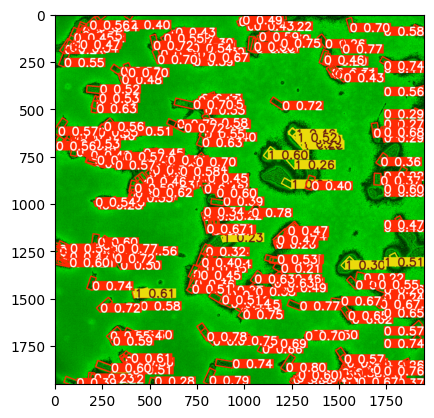

In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
# Load the custom model (best.pt checkpoint)
model = YOLO("/content/drive/MyDrive/Colab Notebooks/3channel_individual/runs/obb/train2/weights/best.pt")  # Replace with the actual path to your best.pt

# Predict with the model
results = model("/content/drive/MyDrive/Colab Notebooks/Data/ND2/20mins021.png", conf=0.15)  # Predict on the image
print(results)

# Display the results
plt.imshow(results[0].plot())  # Plot the image with predictions


Saved 3-channel image to: /content/drive/MyDrive/Colab Notebooks/Test/7.1- 003-1.png


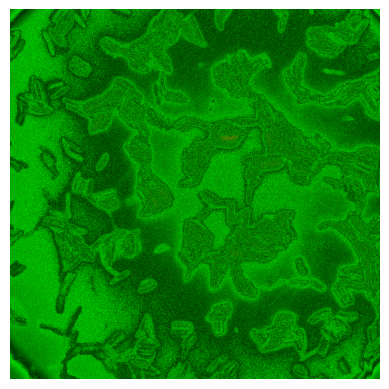

In [ ]:
convert_nd2_first_frame_to_3channel_png('/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.nd2', output_path='/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003-1.png')

In [ ]:
convert_nd2_to_png('/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.nd2', output='/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003-1.png')

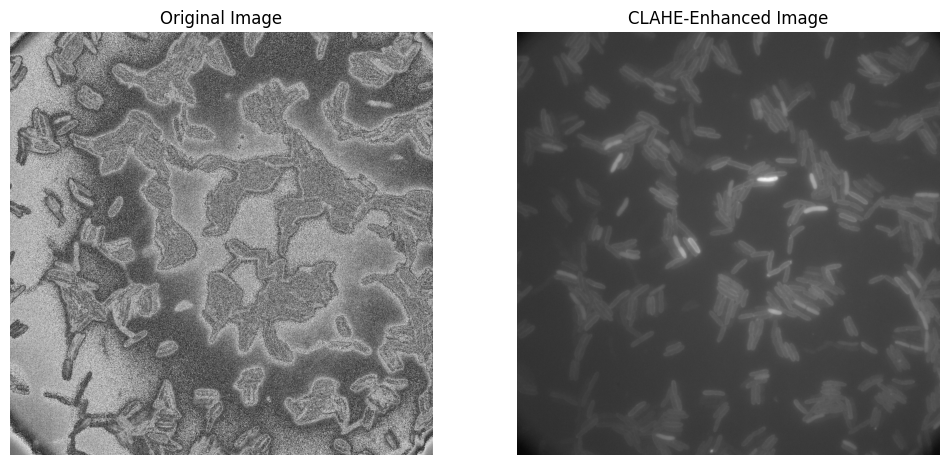

Gamma-corrected image saved at: /content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png


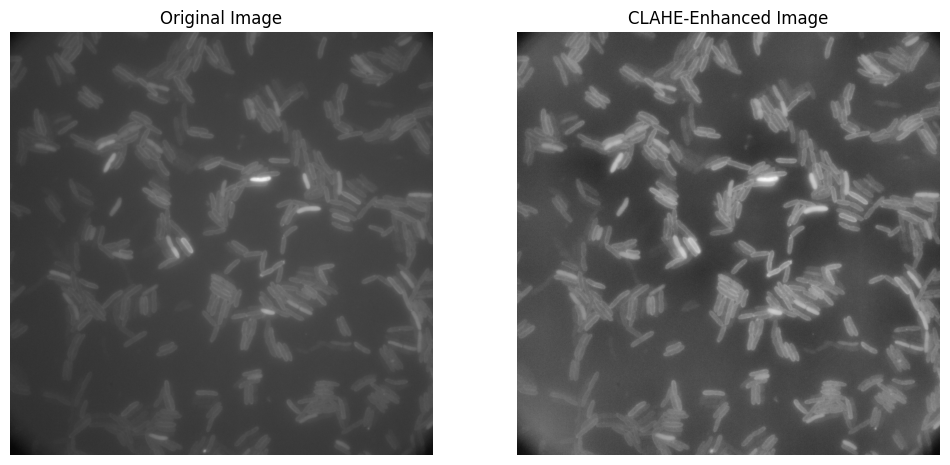

Enhanced image saved at: /content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png


array([[93, 90, 91, ..., 96, 93, 91],
       [88, 90, 90, ..., 93, 94, 93],
       [91, 90, 90, ..., 94, 96, 93],
       ...,
       [99, 97, 90, ..., 88, 93, 91],
       [97, 91, 90, ..., 87, 87, 90],
       [94, 90, 94, ..., 87, 87, 88]], dtype=uint8)

In [ ]:
gamma_correction('/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.nd2')
apply_clahe('/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png')


image 1/1 /content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png: 704x704 None11.8ms
Speed: 4.1ms preprocess, 11.8ms inference, 20.6ms postprocess per image at shape (1, 3, 704, 704)


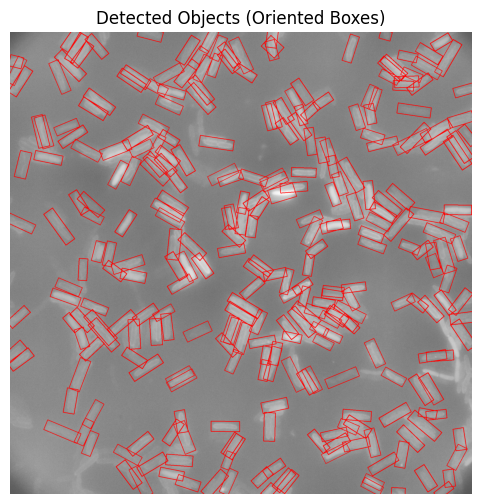

In [ ]:
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import numpy as np

# Load the YOLO model
model = YOLO("/content/drive/MyDrive/Colab Notebooks/3channel_individual/runs/obb/train2/weights/best.pt")

# Run inference
results = model("/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png", conf=0.1)

# Load the image
image_path = "/content/drive/MyDrive/Colab Notebooks/Test/7.1- 003.png"
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for Matplotlib

points = {}  # List to store bounding box points

with open('/content/drive/MyDrive/Colab Notebooks/Test/4hrs incu004.txt', 'w') as f:
    if results[0].obb is not None:
        box=1
        for obb in results[0].obb.xyxyxyxy:  # 8-point format (x1, y1, x2, y2, x3, y3, x4, y4)
            obb = obb.cpu().numpy()  # Move tensor to CPU and convert to numpy array
            box_points = obb.reshape((-1, 2)).astype(int).tolist()  # Convert to list of coordinates
            points[box]=box_points  # Store in list
            box+=1
            cv2.polylines(image, [np.array(box_points)], isClosed=True, color=(255, 0, 0), thickness=2)  # Draw OBB


        f.write(str(points))  # Store full list in the file

    else:
        print("No objects detected.")
points
# Display image with oriented bounding boxes
plt.figure(figsize=(8, 6))
plt.imshow(image)
plt.axis("off")  # Hide axes
plt.title("Detected Objects (Oriented Boxes)")
plt.show()


In [ ]:
points[1]

[[463, 1483], [467, 1394], [438, 1393], [433, 1482]]


image 1/1 /content/drive/MyDrive/Colab Notebooks/Data/ND2/200ms-0.4%-005.png: 704x704 None12.4ms
Speed: 4.2ms preprocess, 12.4ms inference, 7.1ms postprocess per image at shape (1, 3, 704, 704)


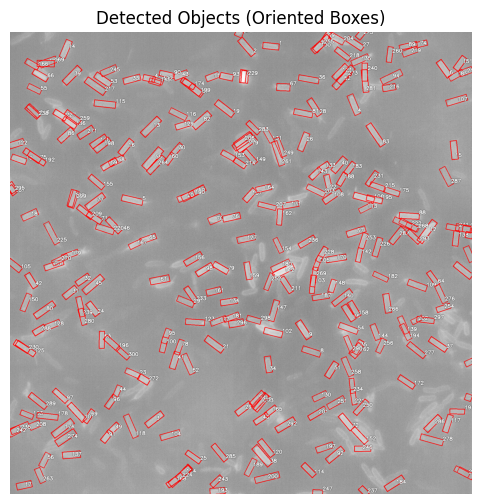

In [ ]:
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import numpy as np

# Load the YOLO model
model = YOLO("/content/drive/MyDrive/Colab Notebooks/runs/obb/train14/weights/best.pt")

# Run inference
results = model("/content/drive/MyDrive/Colab Notebooks/Data/ND2/200ms-0.4%-005.png", conf=0.02)

# Load the image
image_path = "/content/drive/MyDrive/Colab Notebooks/Data/ND2/200ms-0.4%-005.png"
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for Matplotlib

points = {}  # Dictionary to store bounding box points

with open('/content/drive/MyDrive/Colab Notebooks/Data/ND2/200ms-0.4%-005.txt', 'w') as f:
    if results[0].obb is not None:
        box = 1
        for obb in results[0].obb.xyxyxyxy:  # 8-point format (x1, y1, x2, y2, x3, y3, x4, y4)
            obb = obb.cpu().numpy()  # Move tensor to CPU and convert to numpy array
            box_points = obb.reshape((-1, 2)).astype(int).tolist()  # Convert to list of coordinates
            points[box] = box_points  # Store in dictionary

            # Draw bounding box
            cv2.polylines(image, [np.array(box_points)], isClosed=True, color=(255, 0, 0), thickness=2)

            # Determine label position (center of top edge)
            label_x = (box_points[0][0] + box_points[1][0]) // 2  # Midpoint of top two points
            label_y = (box_points[0][1] + box_points[1][1]) // 2 - 10  # Slightly above

            # Outline the text for better visibility
            cv2.putText(image, str(box), (label_x, label_y), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (0, 0, 0), 3, cv2.LINE_AA)  # Black outline
            cv2.putText(image, str(box), (label_x, label_y), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (255, 255, 255), 2, cv2.LINE_AA)  # White text

            box += 1

        f.write(str(points))  # Store full list in the file

    else:
        print("No objects detected.")

# Display image with oriented bounding boxes
plt.figure(figsize=(8, 6))
plt.imshow(image)
plt.axis("off")  # Hide axes
plt.title("Detected Objects (Oriented Boxes)")
plt.show()
